In [21]:
!pip install imagehash

Defaulting to user installation because normal site-packages is not writeable


In [22]:
from PIL import Image
import numpy as np
import pandas as pd
import os
import numpy as np
import imagehash
import matplotlib.pyplot as plt
import random

In [23]:
# from google.colab import drive

# drive.mount("/content/drive")

# Define TRAIN dataset
<li><strong>TRAIN_IMG_PATH</strong>: Train image folder path</li>
<li><strong>TRAIN_MASK_PATH</strong>: Train mask folder path</li>

In [24]:
# GDrive Files
# TRAIN_IMG_PATH = "/content/drive/MyDrive/AI/Cityscape/images_prepped_train-20230811T065243Z-001/images_prepped_train"
# TRAIN_MASK_PATH = "/content/drive/MyDrive/AI/Cityscape/annotations_prepped_train-20230811T065240Z-001/annotations_prepped_train"
# TEST_IMG_PATH = "/content/drive/MyDrive/AI/Cityscape/images_prepped_test-20230811T065241Z-001"
# TEST_MASK_PATH = "/content/drive/MyDrive/AI/Cityscape/annotations_prepped_test-20230811T065240Z-001"

# EDA_DS_PATH = "/content/drive/MyDrive/AI/Advance CV - Project 3/Dataset"
# EDA_TRAIN_LABELS = os.path.join(EDA_DS_PATH, "train_labels.csv")
# EDA_TRAIN_FILES = os.path.join(EDA_DS_PATH, "train_files.csv")
# EDA_VAL_FILES = os.path.join(EDA_DS_PATH, "val_files.csv")

# MODEL_PATH = "/content/drive/MyDrive/AI/Advance CV - Project 3/models/UNet"
# MODEL_PATH_FCN8S = "/content/drive/MyDrive/AI/Advance CV - Project 3/models/FCN8s"

# Local File
TRAIN_IMG_PATH = "./dataset/bootcamp/train/images"
TRAIN_MASK_PATH = "./dataset/bootcamp/train/annotations"
VAL_IMG_PATH = "./dataset/bootcamp/test/images"
VAL_MASK_PATH = "./dataset/bootcamp/test/annotations"

EDA_DS_PATH = "./dataset/bootcamp/train"
EDA_TRAIN_LABELS = os.path.join(EDA_DS_PATH, "train_labels.csv")
EDA_TRAIN_FILES = os.path.join(EDA_DS_PATH, "train_files.csv")
EDA_VAL_FILES = os.path.join(EDA_DS_PATH, "val_files.csv")

METRIC_PATH = "./metrics"

Check the number of image and mask files. Use only files that have a matching image-mask pair.

In [25]:
val_mask_files = os.listdir(VAL_MASK_PATH)
print(f"Total number of validation mask files: {len(val_mask_files)}")
val_image_files = os.listdir(VAL_IMG_PATH)
print(f"Total number of validation image files: {len(val_image_files)}")
val_files = [x for x in val_mask_files if x in val_image_files]
print(f"Total number of validation matching files: {len(val_files)}")

# no need to process validation file, just save the lists
val_files_df = pd.DataFrame(val_files, columns=['filename'])
val_files_df.to_csv(EDA_VAL_FILES, index=False)


Total number of validation mask files: 101
Total number of validation image files: 101
Total number of validation matching files: 101


Check the number of image and mask files. Use only files that have a matching image-mask pair.

In [26]:
mask_files = os.listdir(TRAIN_MASK_PATH)
print(f"Total number of mask files: {len(mask_files)}")

image_files = os.listdir(TRAIN_IMG_PATH)
print(f"Total number of image files: {len(image_files)}")

files = [x for x in image_files if x in mask_files]
print(f"Total number of matching files: {len(files)}")

Total number of mask files: 367
Total number of image files: 398
Total number of matching files: 367


## Check Image Duplication

Check for image duplications based on hash result of the file.

In [27]:
def calculate_multiple_hashes(image_path):
    """Calculates multiple hash types for better comparison."""
    try:
        img = Image.open(image_path)
        hashes = {
            'phash': imagehash.phash(img),
            'ahash': imagehash.average_hash(img),
            'dhash': imagehash.dhash(img),
            'whash': imagehash.whash(img)
        }
        return hashes
    except Exception as e:
        print(f"Error processing {image_path}: {e}")
        return None

def find_duplicate_images(image_folder, images_list, threshold=5):
    """Finds duplicate images based on multiple hash comparisons."""
    hash_dict = {}
    duplicates = []

    for image_path in images_list:
        full_path = os.path.join(image_folder, image_path)
        hashes = calculate_multiple_hashes(full_path)
        if hashes is None:
            continue

        # Compare with existing hashes
        duplicate_found = False
        for existing_path, existing_hashes in hash_dict.items():
            match_score = 0
            total_hashes = 0

            for hash_type in hashes:
                if hash_type in existing_hashes:
                    # Calculate hamming distance between hashes
                    distance = hashes[hash_type] - existing_hashes[hash_type]
                    if distance <= threshold:  # Considered similar if within threshold
                        match_score += 1
                    total_hashes += 1

            # If majority of hashes match, consider it a duplicate
            if total_hashes > 0 and match_score / total_hashes >= 0.75:
                duplicates.append((existing_path, image_path))
                duplicate_found = True
                break

        if not duplicate_found:
            hash_dict[image_path] = hashes

    return duplicates

In [28]:
image_folder = TRAIN_IMG_PATH
duplicates = find_duplicate_images(image_folder, files)
print(duplicates)

[('0001TP_006690.png', '0001TP_006720.png'), ('0001TP_006840.png', '0001TP_006870.png'), ('0001TP_007890.png', '0001TP_007920.png'), ('0001TP_008040.png', '0001TP_008070.png'), ('0001TP_008040.png', '0001TP_008160.png'), ('0001TP_008190.png', '0001TP_008250.png'), ('0001TP_008100.png', '0001TP_008280.png'), ('0006R0_f02280.png', '0006R0_f02310.png'), ('0006R0_f02340.png', '0006R0_f02370.png'), ('0016E5_01230.png', '0016E5_01260.png'), ('0016E5_01290.png', '0016E5_01320.png'), ('0016E5_04410.png', '0016E5_04440.png'), ('0016E5_04410.png', '0016E5_04470.png'), ('0016E5_04410.png', '0016E5_04500.png'), ('0016E5_04410.png', '0016E5_04530.png'), ('0016E5_04800.png', '0016E5_04830.png'), ('0016E5_04860.png', '0016E5_04890.png'), ('0016E5_04860.png', '0016E5_04920.png'), ('0016E5_04800.png', '0016E5_04950.png'), ('0016E5_04860.png', '0016E5_04980.png'), ('0016E5_04860.png', '0016E5_05010.png'), ('0016E5_04860.png', '0016E5_05040.png'), ('0016E5_04860.png', '0016E5_05070.png'), ('0016E5_04800.

Show and analyze duplicated images (pick 5 images)

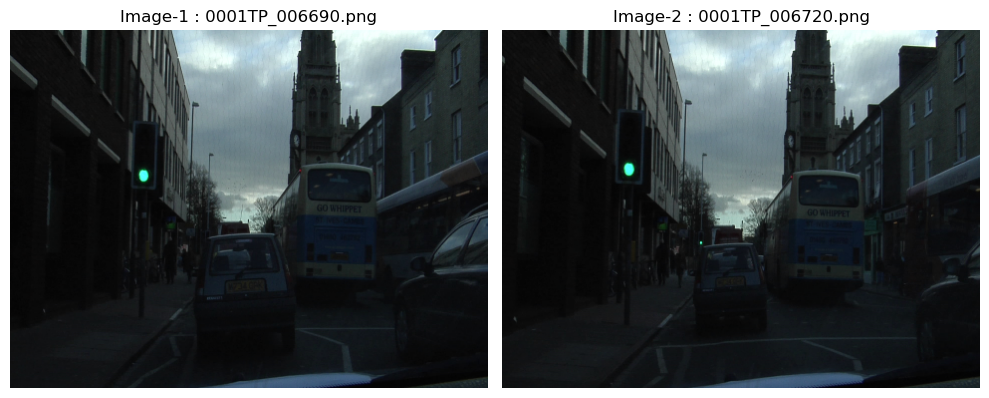

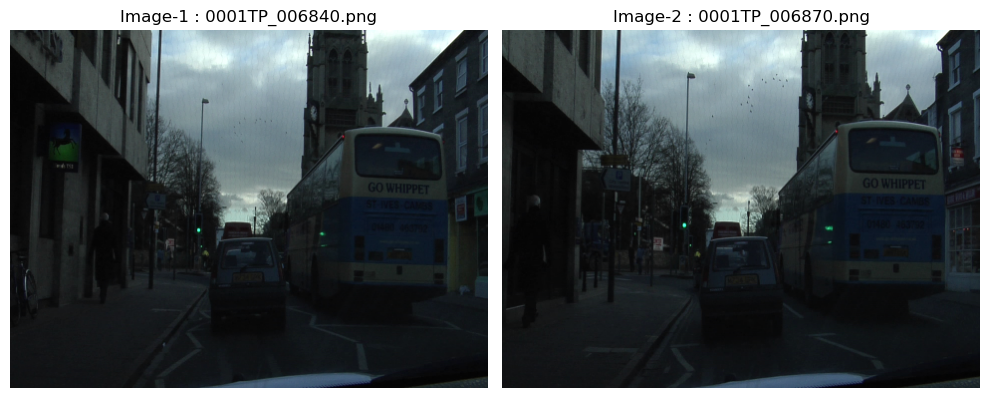

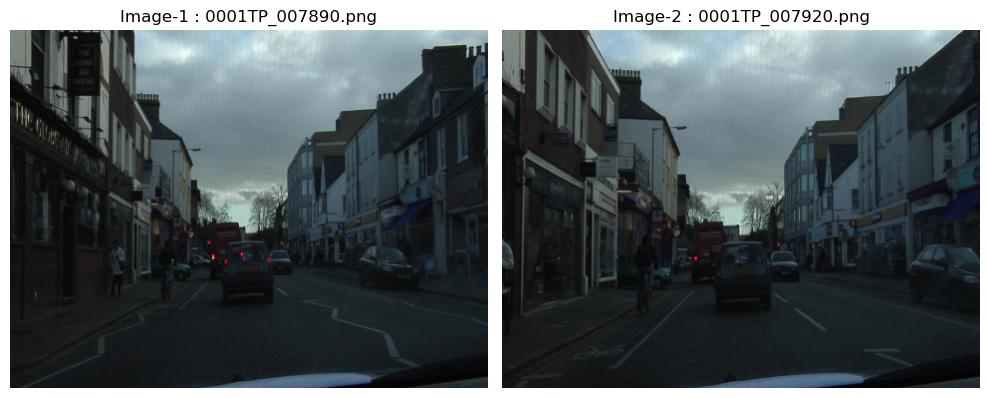

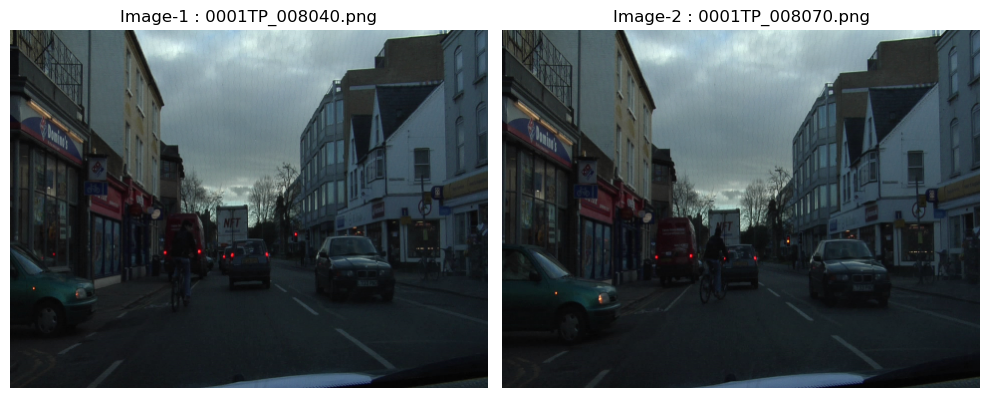

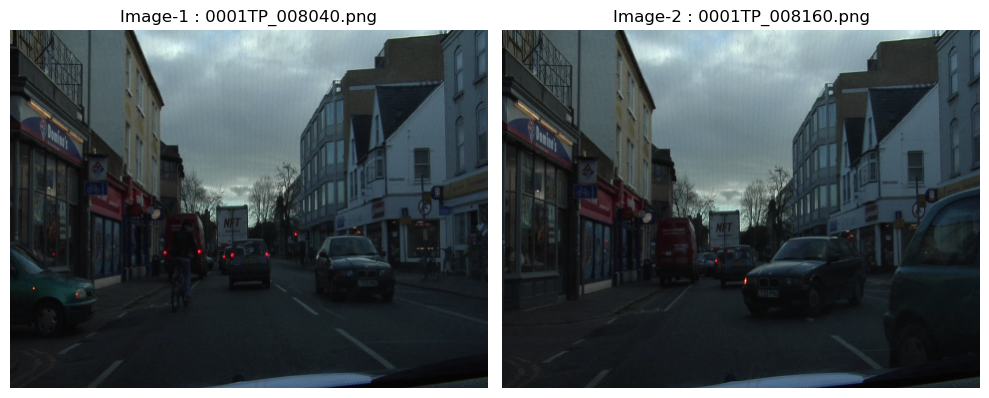

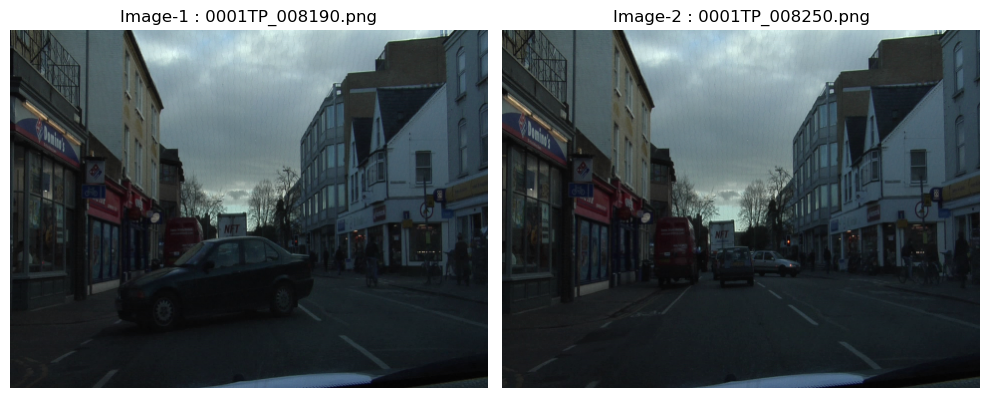

In [29]:
def show_duplicate(image_folder, duplicate, mode="RGBA"):
  image1_path = os.path.join(image_folder, duplicate[0])
  image2_path = os.path.join(image_folder, duplicate[1])
  print()
  image1 = Image.open(image1_path).convert(mode)
  image2 = Image.open(image2_path).convert(mode)
  fig, axs = plt.subplots(1, 2, figsize=(10, 10))
  axs[0].imshow(image1)
  axs[0].set_title(f'Image-1 : {duplicate[0]}')
  axs[1].imshow(image2)
  axs[1].set_title(f'Image-2 : {duplicate[1]}')
  for ax in axs:
      ax.axis('off')
  plt.tight_layout()
  plt.show()

for idx, duplicate in enumerate(duplicates):
  if (idx > 5):
    break
  show_duplicate(image_folder, duplicate)

Since not all images with duplicated has is a real duplication. We need to compare features of the images also

In [30]:
import cv2
import numpy as np

def compare_features(image_path1, image_path2):
    """Compare images using feature matching."""
    try:
        img1 = cv2.imread(image_path1, cv2.IMREAD_GRAYSCALE)
        img2 = cv2.imread(image_path2, cv2.IMREAD_GRAYSCALE)

        if img1 is None or img2 is None:
            return 0

        # Initialize ORB detector
        orb = cv2.ORB_create()

        # Find keypoints and descriptors
        kp1, des1 = orb.detectAndCompute(img1, None)
        kp2, des2 = orb.detectAndCompute(img2, None)

        if des1 is None or des2 is None:
            return 0

        # Create BFMatcher object
        bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)

        # Match descriptors
        matches = bf.match(des1, des2)

        # Calculate match ratio
        match_ratio = len(matches) / min(len(des1), len(des2))
        return match_ratio
    except Exception as e:
        print(f"Error comparing features: {e}")
        return 0

def filter_duplicates(duplicates, threshold=0.9):
    """Filter out duplicates based on similarity."""
    filtered_duplicates = []
    for pair in duplicates:
        similarity = compare_features(os.path.join(image_folder, pair[0]), os.path.join(image_folder, pair[1]))
        print(f"Similarity between {pair[0]} and {pair[1]}: {similarity}")
        if similarity >= threshold:
            filtered_duplicates.append(pair)
    return filtered_duplicates

Only conside it as duplicated if the similarity is >= 0.9

In [31]:
duplicates = filter_duplicates(duplicates, threshold=0.9)
print(f"Remaining duplicates: {duplicates}")


Similarity between 0001TP_006690.png and 0001TP_006720.png: 0.5922131147540983
Similarity between 0001TP_006840.png and 0001TP_006870.png: 0.4166666666666667
Similarity between 0001TP_007890.png and 0001TP_007920.png: 0.35
Similarity between 0001TP_008040.png and 0001TP_008070.png: 0.698
Similarity between 0001TP_008040.png and 0001TP_008160.png: 0.7214428857715431
Similarity between 0001TP_008190.png and 0001TP_008250.png: 0.622
Similarity between 0001TP_008100.png and 0001TP_008280.png: 0.458
Similarity between 0006R0_f02280.png and 0006R0_f02310.png: 0.554
Similarity between 0006R0_f02340.png and 0006R0_f02370.png: 0.482
Similarity between 0016E5_01230.png and 0016E5_01260.png: 0.538
Similarity between 0016E5_01290.png and 0016E5_01320.png: 0.544
Similarity between 0016E5_04410.png and 0016E5_04440.png: 0.688
Similarity between 0016E5_04410.png and 0016E5_04470.png: 0.764
Similarity between 0016E5_04410.png and 0016E5_04500.png: 0.726
Similarity between 0016E5_04410.png and 0016E5_0

Remove the duplication only if it is a real duplication. This code is not executed since there is no duplication after feature similary comparison check

In [32]:
def remove_duplicate(src, duplicate):
  for d in duplicates:
    src.remove(d[1])
  return src

files = remove_duplicate(files, duplicates)


In [33]:
classes_np = np.array([])

# store the filenames that contain each class
# to analyze the class
classes_dict = {}

for file in files:
    mask_path = os.path.join(TRAIN_MASK_PATH, file)
    mask = Image.open(mask_path).convert('L')
    mask_np = np.array(mask)
    unique_np = np.unique(mask_np)

    # Increment for class appearance
    for unique_val in unique_np:
        arr = classes_dict.get(unique_val, [])
        arr.append(file)
        classes_dict[unique_val] = arr

    classes_np = np.concatenate((classes_np, unique_np))
    classes_np = np.unique(classes_np)


In [34]:
# Show files that has the specific class
min_count = float('inf')
min_class = -1
for key in sorted(classes_dict):
    print(f"class {key}: {len(classes_dict[key])}")
    if min_count > len(classes_dict[key]):
        min_count = len(classes_dict[key])
        min_class = key

print(f'Class with min occurance in files: class: {min_class} with count: {min_count}')

class 0: 366
class 1: 365
class 2: 366
class 3: 367
class 4: 349
class 5: 319
class 6: 351
class 7: 173
class 8: 360
class 9: 317
class 10: 201
class 11: 367
Class with min occurance in files: class: 7 with count: 173


In [35]:
test_img = Image.open(os.path.join(TRAIN_IMG_PATH, files[0]))
img_mode = test_img.mode
print(f"Image mode: {img_mode}")
test_mask = Image.open(os.path.join(TRAIN_MASK_PATH, files[0]))
mask_mode = test_mask.mode
print(f"Mask Mode: {mask_mode}")

Image mode: RGB
Mask Mode: L


In [36]:
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches

# function to show image, overlay of specific class and image overlayed with specific class
def show(image_path, mask_path, show_classes=[], img_mode='RGB', mask_mode='L', void_color=[0,0,0], title=''):
  # Load images
  image = Image.open(image_path).convert(img_mode)
  mask = Image.open(mask_path).convert(mask_mode)  # Class labels
  # mask = Image.open(mask_path).convert('RGB')  # Class labels
  mask = mask.resize(image.size, resample=Image.NEAREST)
  mask_np = np.array(mask)
  classes_np = np.unique(mask_np)
  if len(show_classes) == 0:
    show_classes = classes_np

  filtered_mask_np = np.where(np.isin(mask_np, show_classes), mask_np, 255)
  filtered_mask = Image.fromarray(filtered_mask_np)

  image_np = np.array(image)

  filtered_image_np = image_np.copy()
  filtered_image_np[filtered_mask_np == 255] = void_color
  filtered_image = Image.fromarray(filtered_image_np)

  # Display 3-panel image
  fig, axs = plt.subplots(1, 3, figsize=(12, 5))
  axs[0].imshow(image)
  axs[0].set_title('Original Image')
  axs[1].imshow(filtered_mask)
  axs[1].set_title('Segmentation Mask')
  axs[2].imshow(filtered_image)
  axs[2].set_title('Overlay')
  if len(title) > 0:
    plt.suptitle(title, fontsize=14, y=1.05)

  for ax in axs:
    ax.axis('off')
  plt.tight_layout()
  plt.show()

## Analyze each classes

pick 5 images of each classes to view the class object clearly

In [37]:
# randomly pick 5 iamges
random.seed(12)  # Set the seed for reproducibility
random_values = random.sample(range(0, len(files) + 1), 10)
print(random_values)

show_files = []
for i in random_values:
  show_files.append(files[i])
print(show_files)

[242, 137, 336, 270, 341, 179, 73, 195, 5, 191]
['0016E5_04680.png', '0006R0_f03180.png', '0016E5_07500.png', '0016E5_05520.png', '0016E5_07650.png', '0016E5_00870.png', '0006R0_f01260.png', '0016E5_01350.png', '0001TP_006840.png', '0016E5_01230.png']


Class: 0


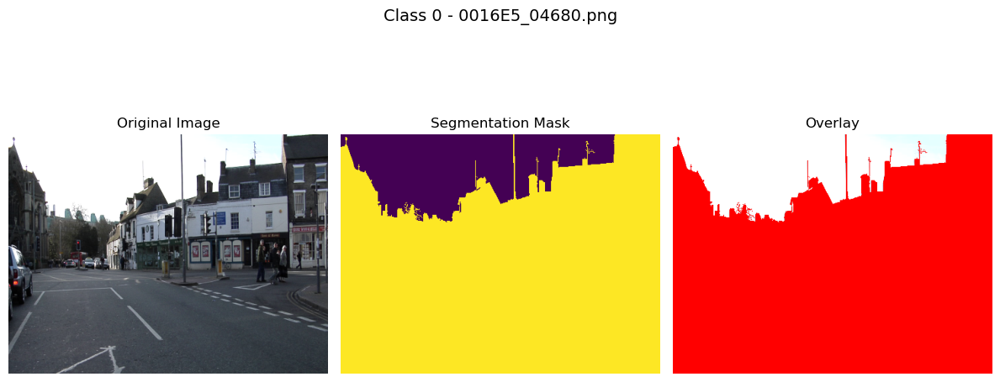

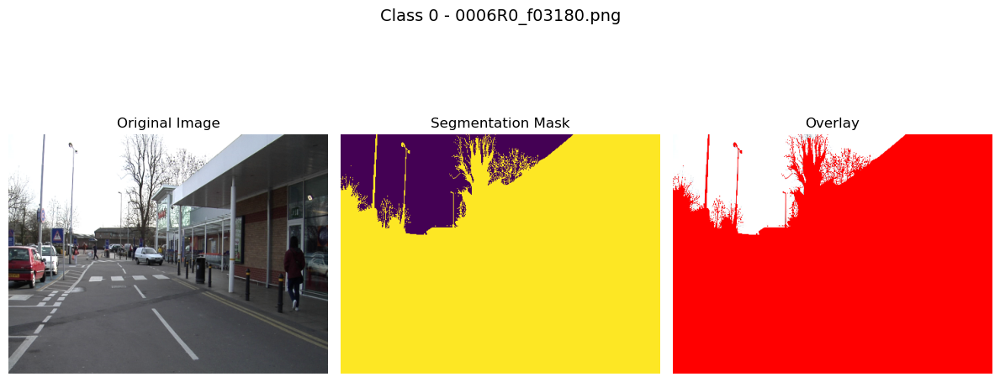

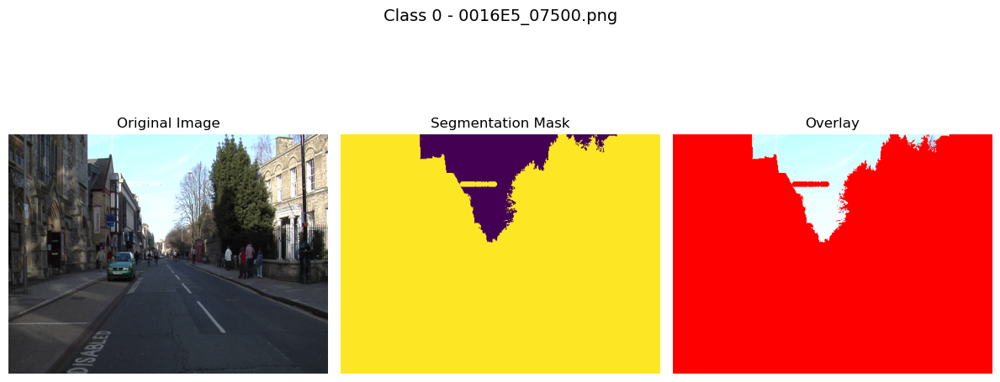

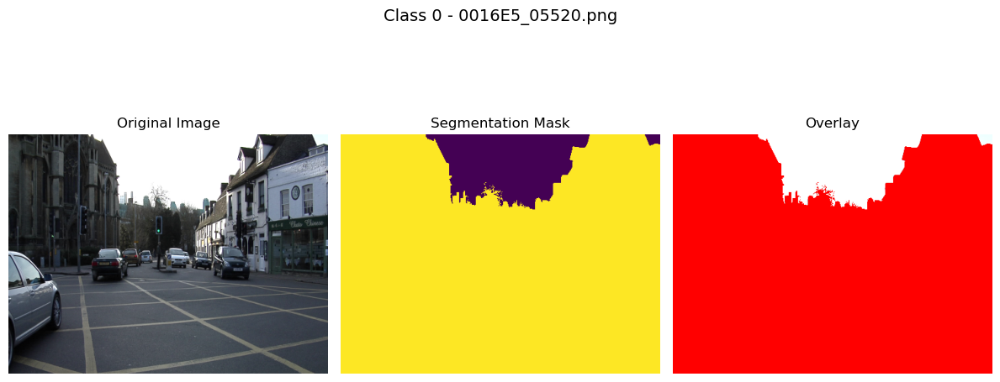

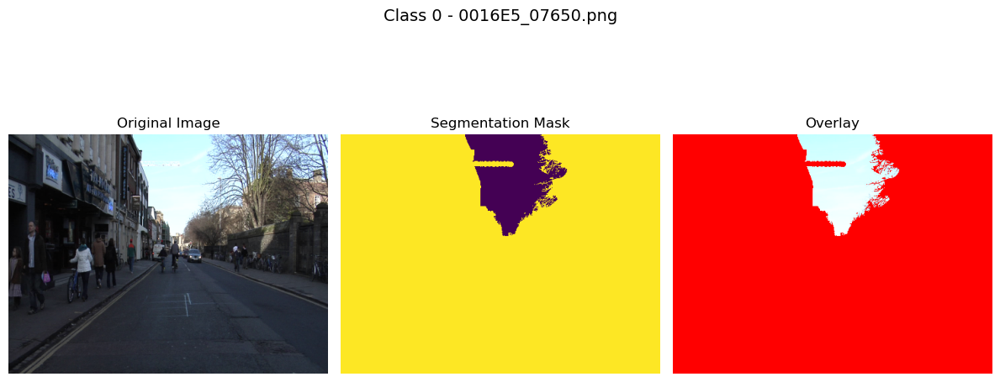

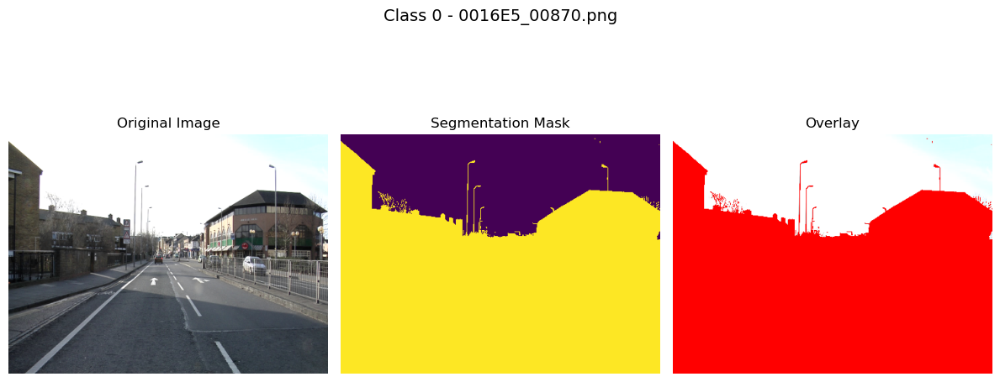

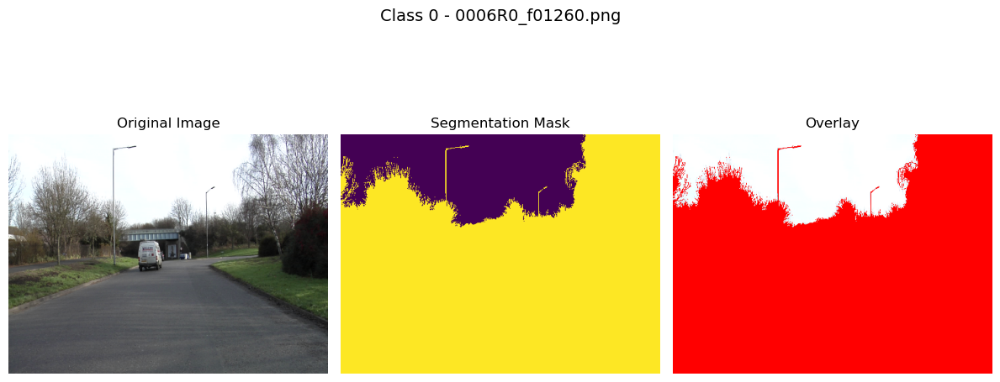

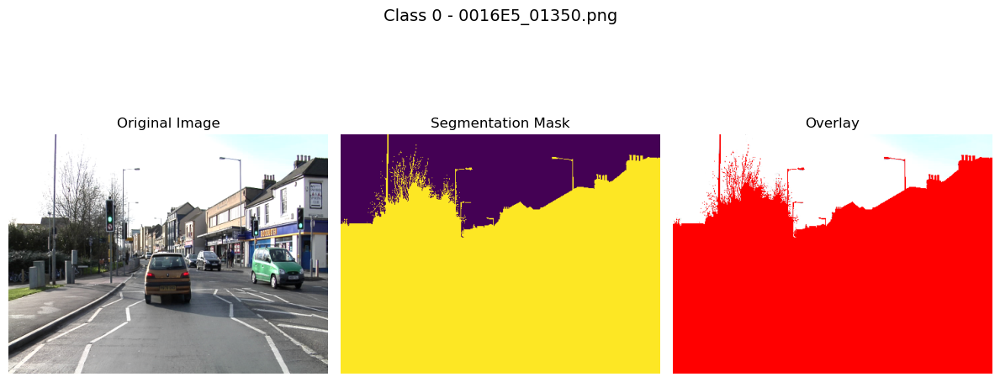

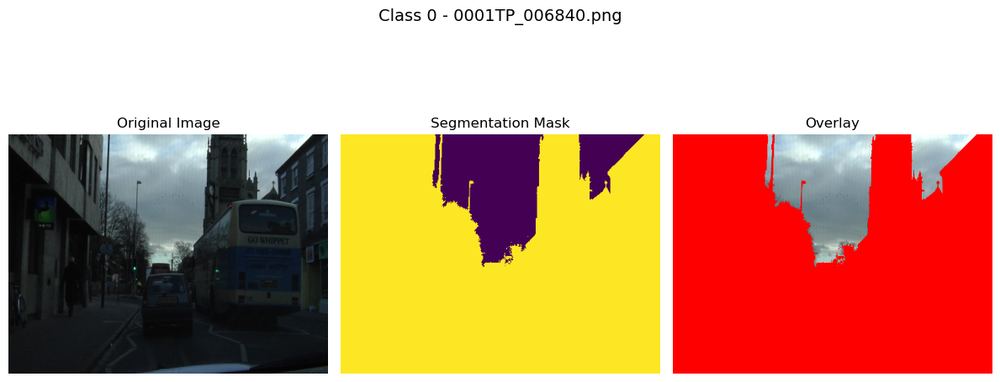

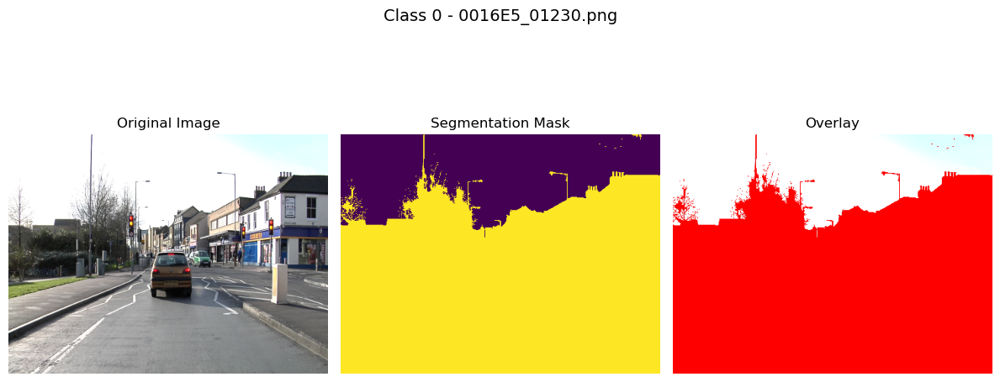

Class: 1


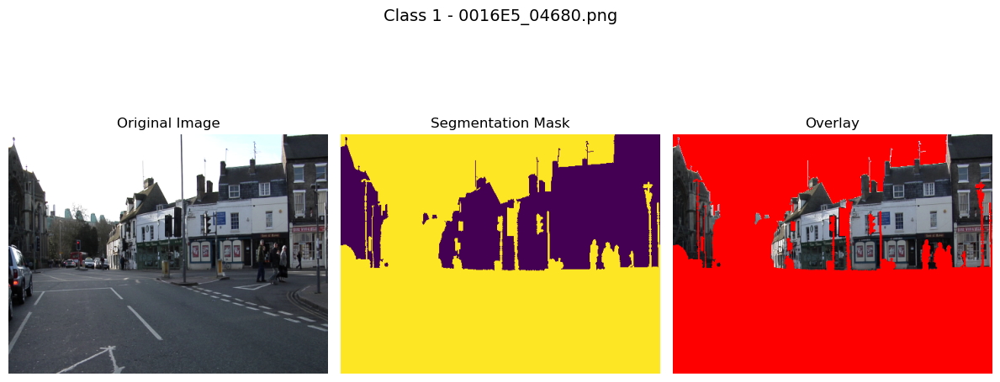

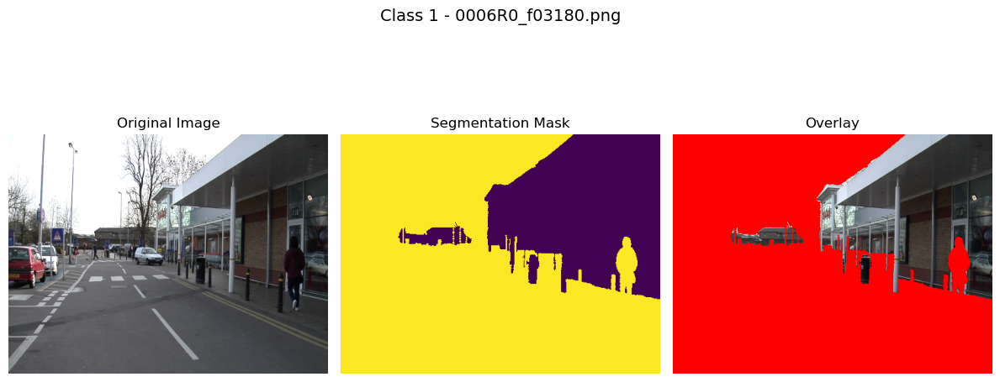

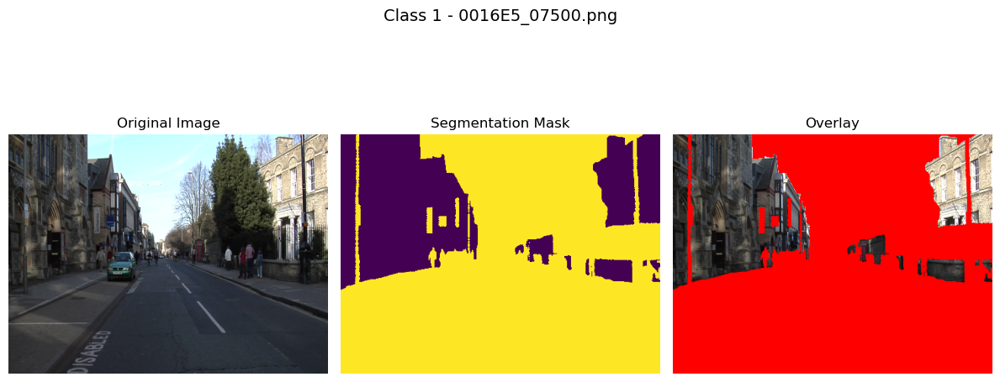

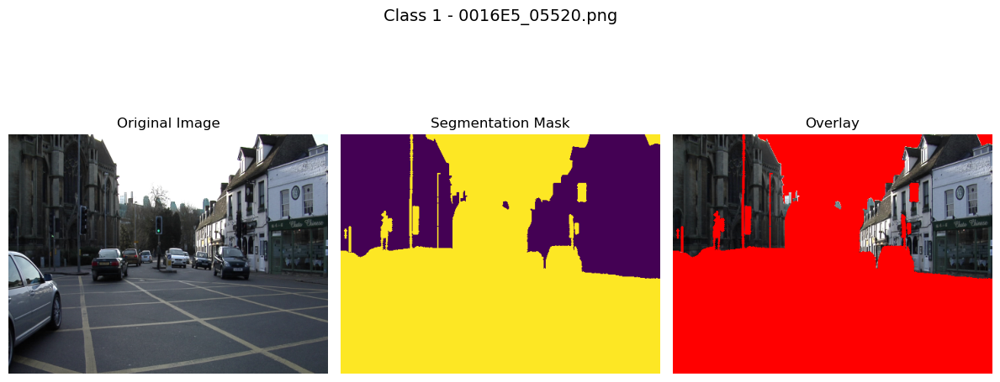

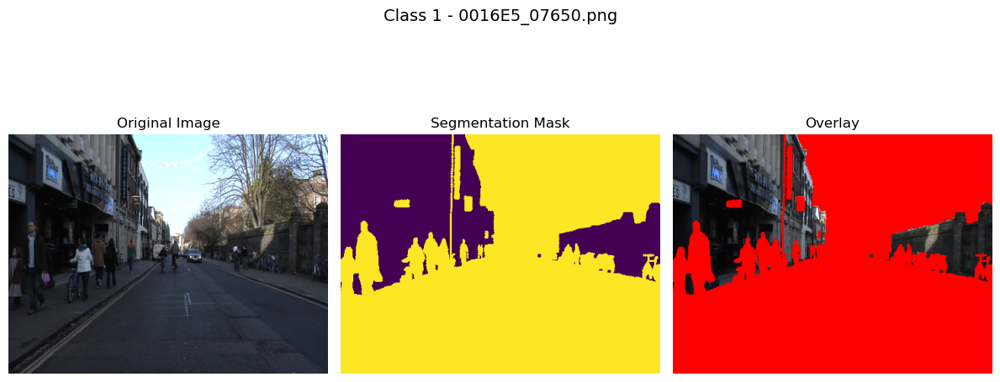

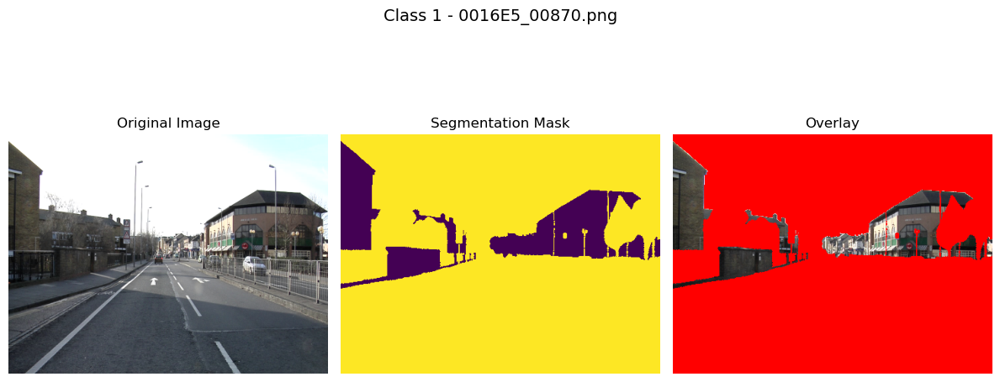

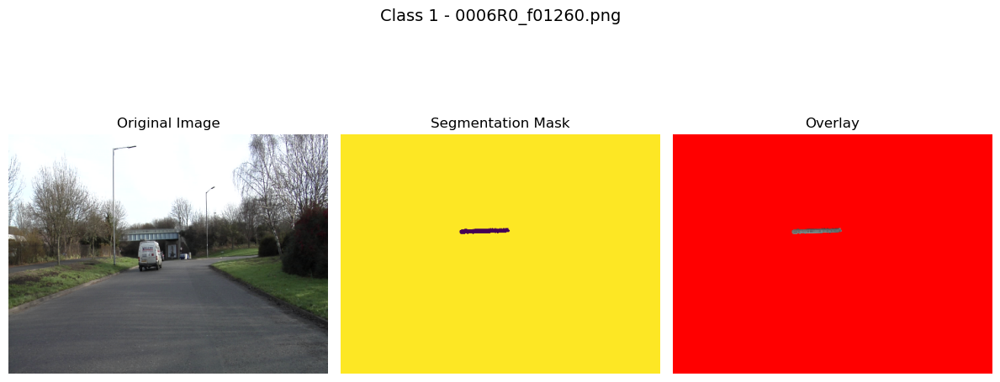

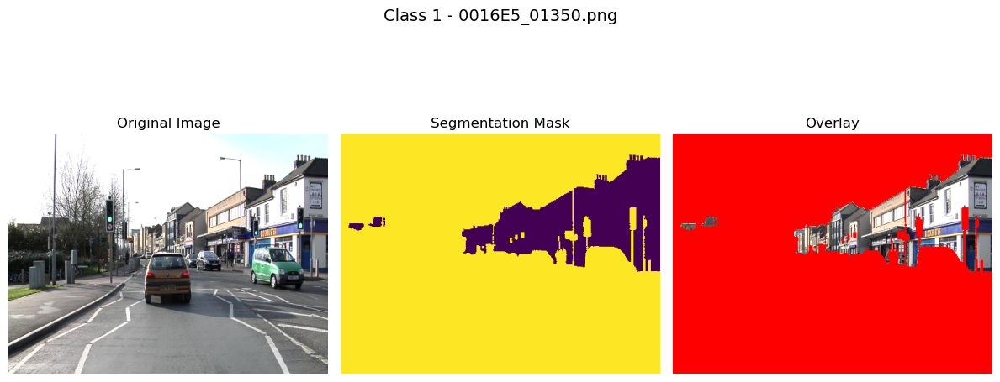

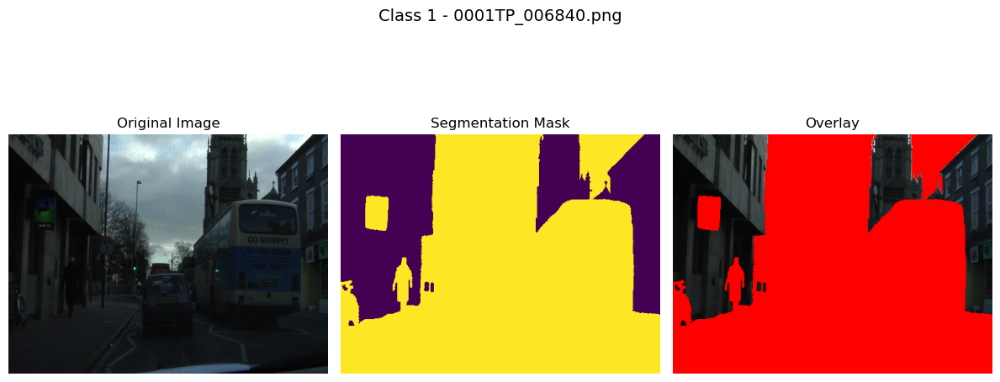

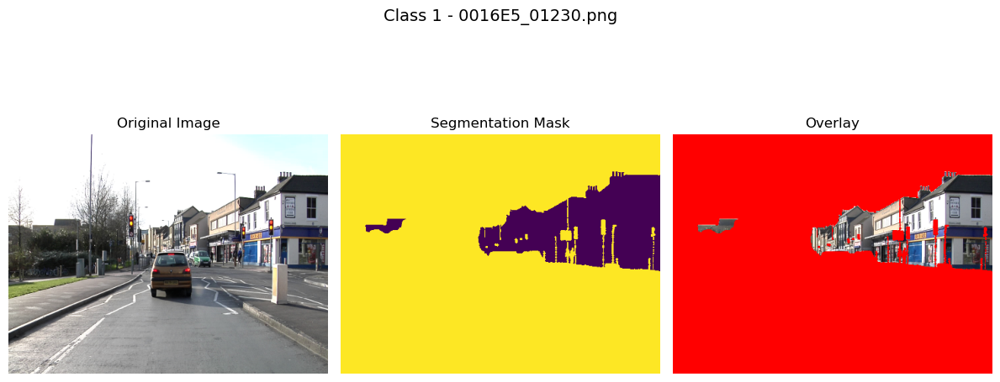

Class: 2


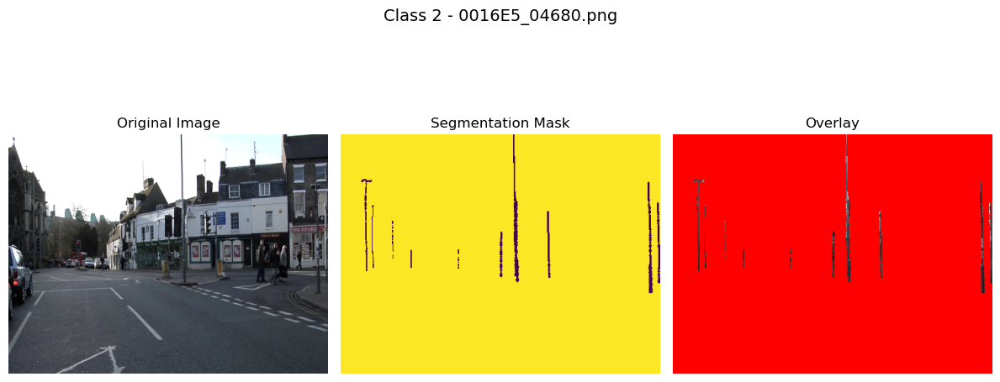

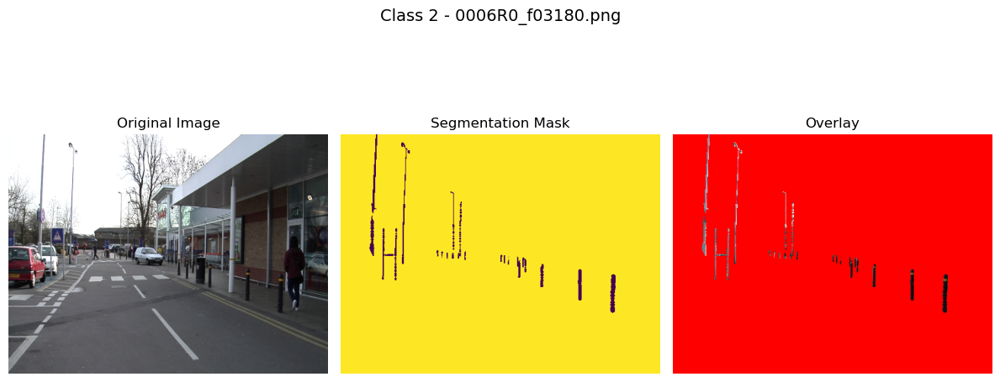

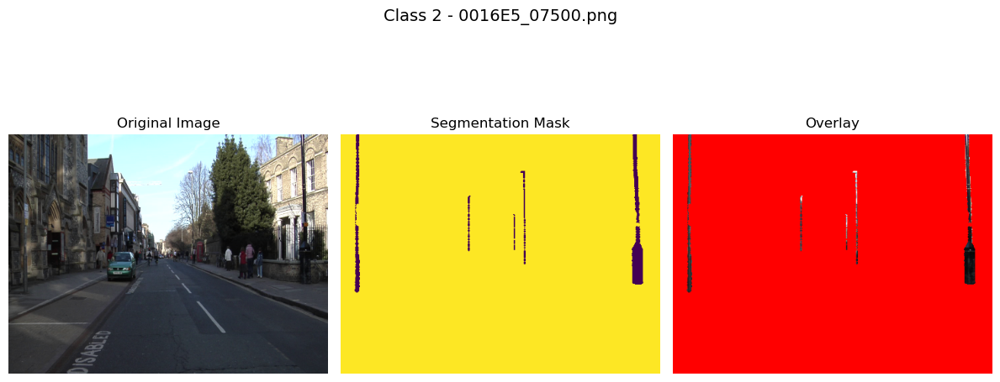

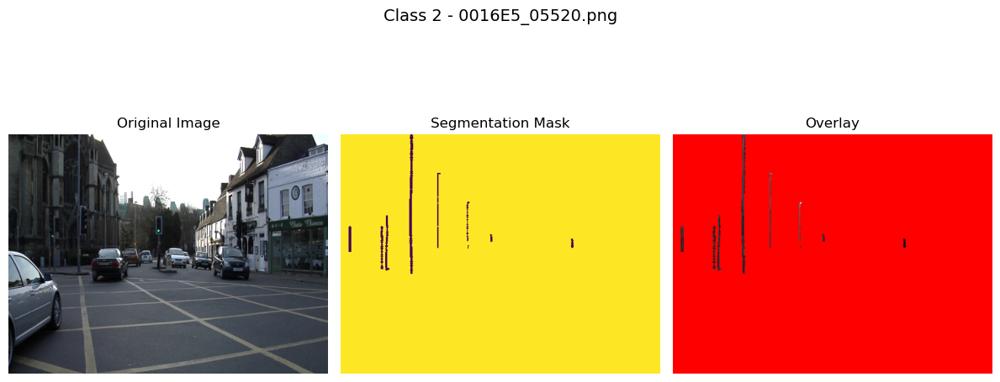

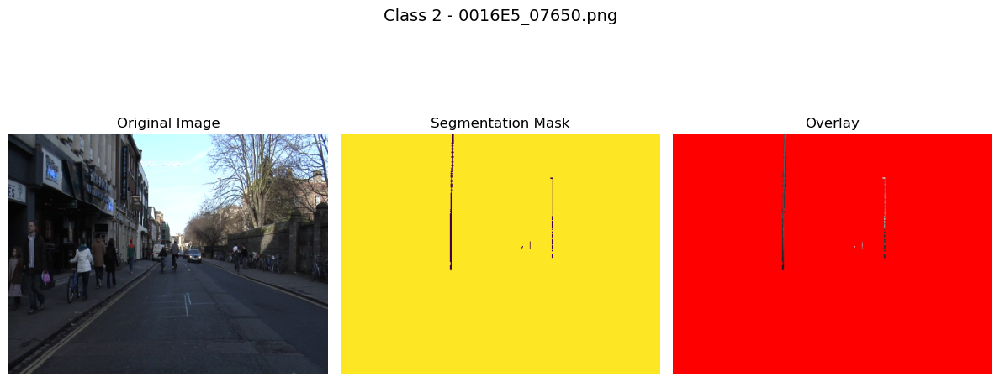

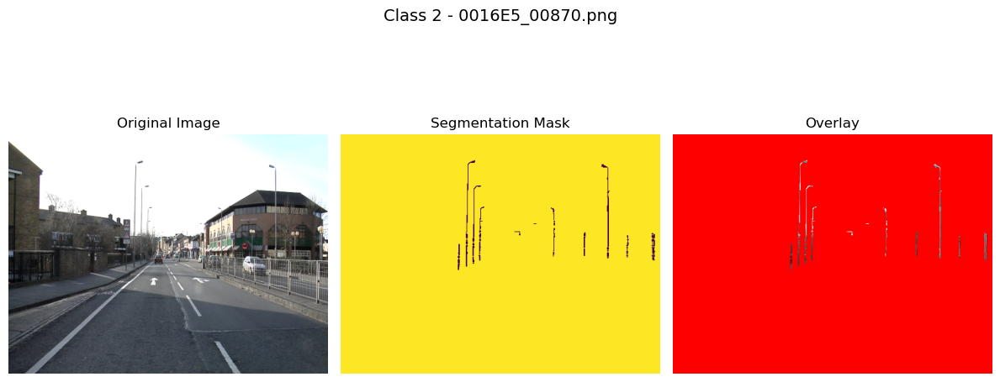

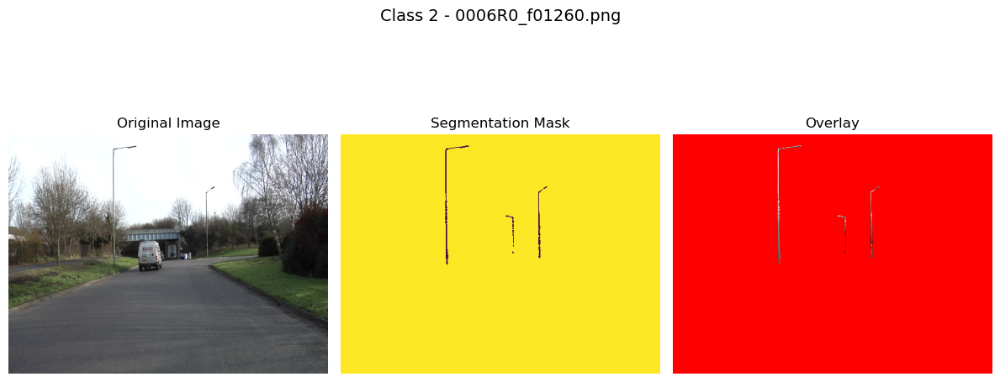

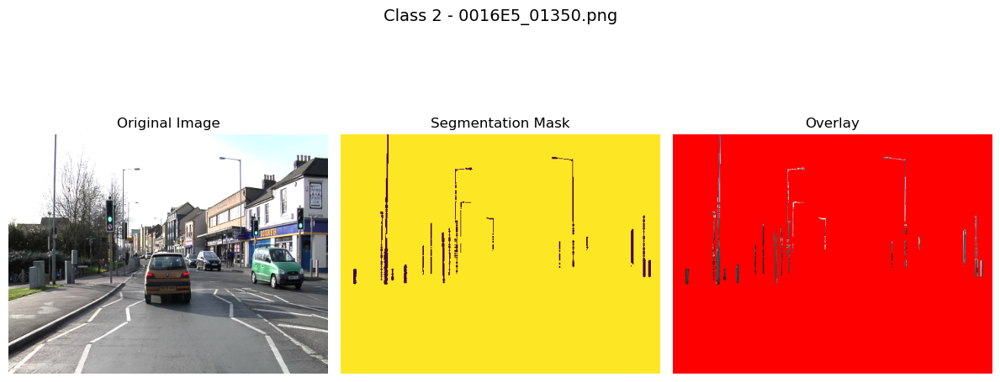

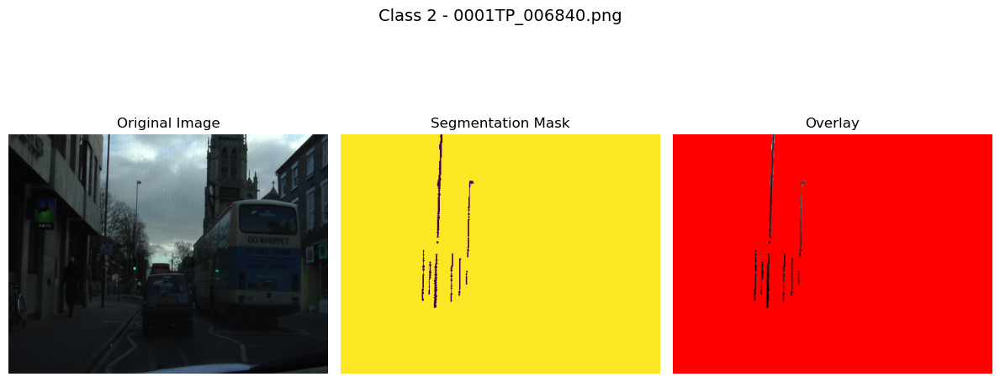

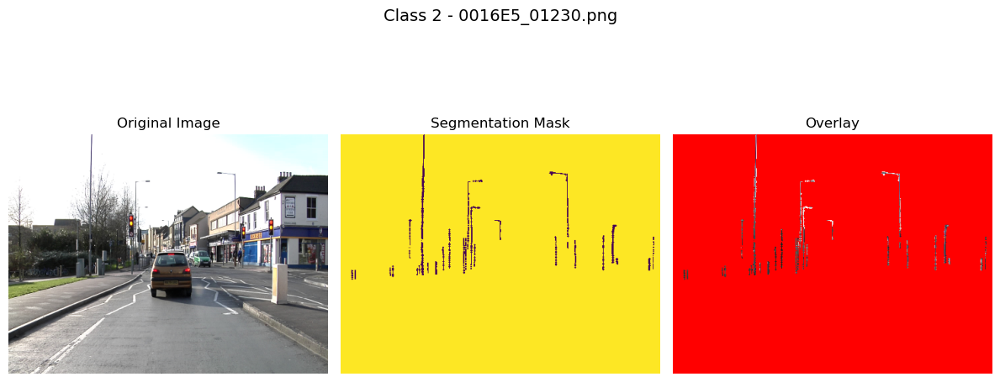

Class: 3


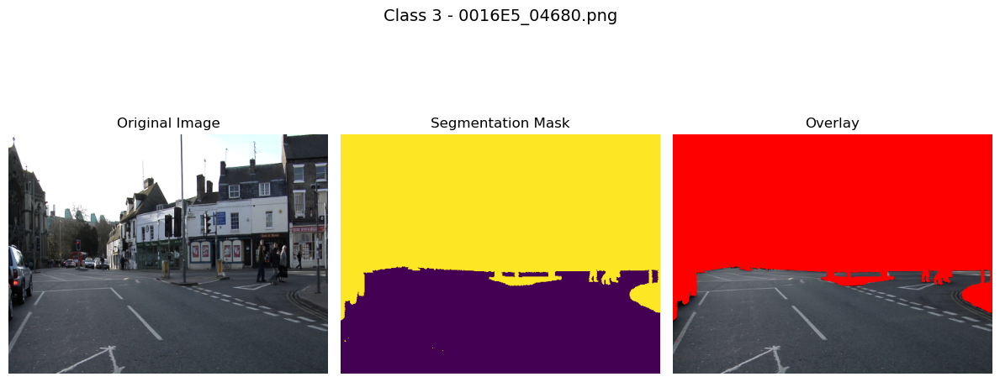

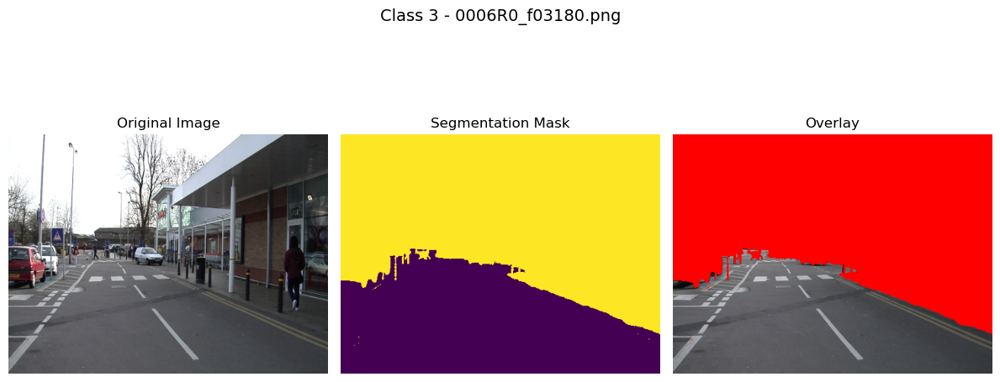

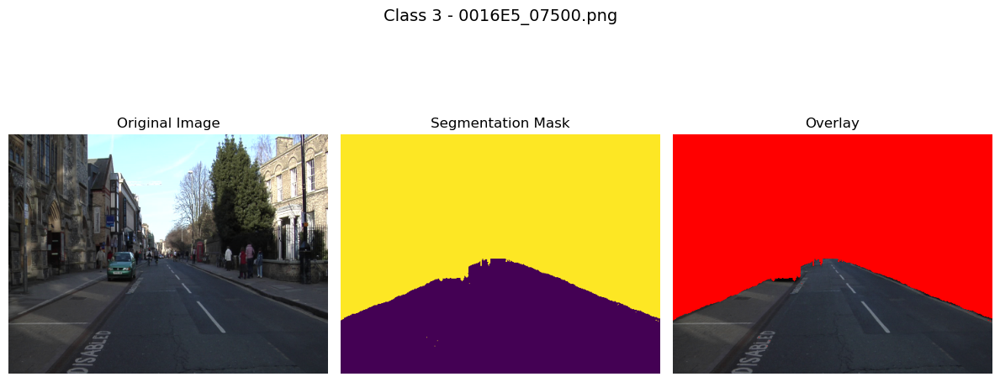

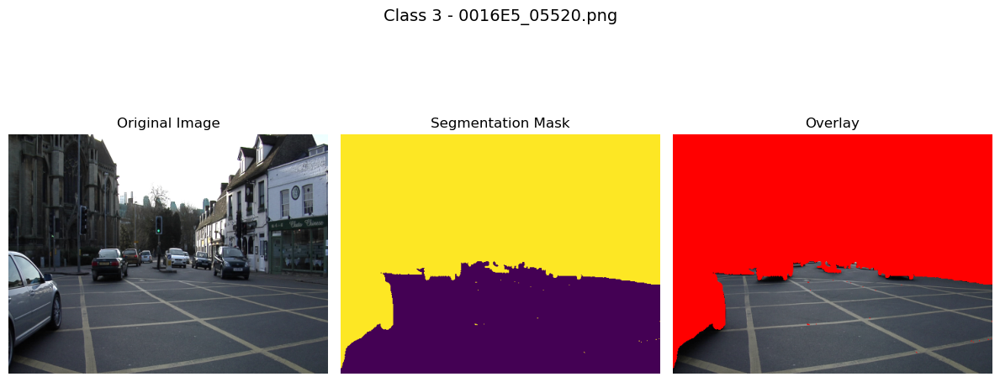

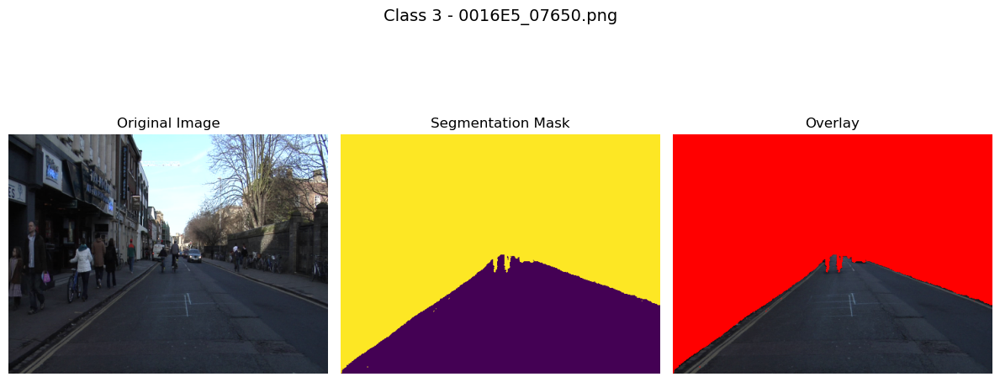

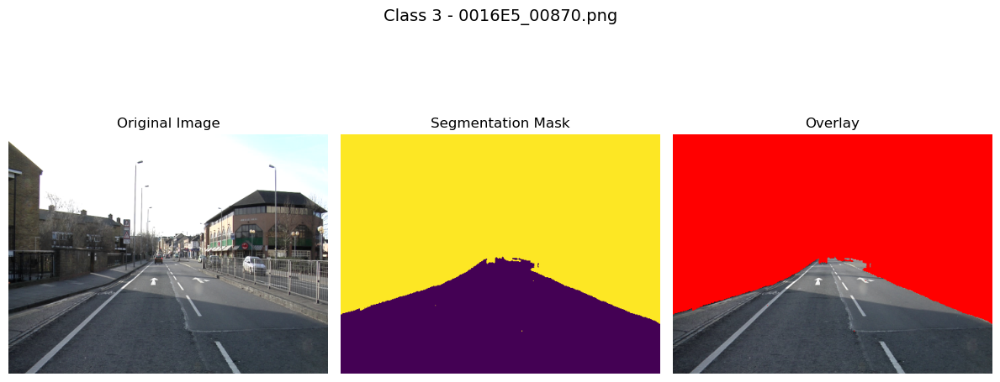

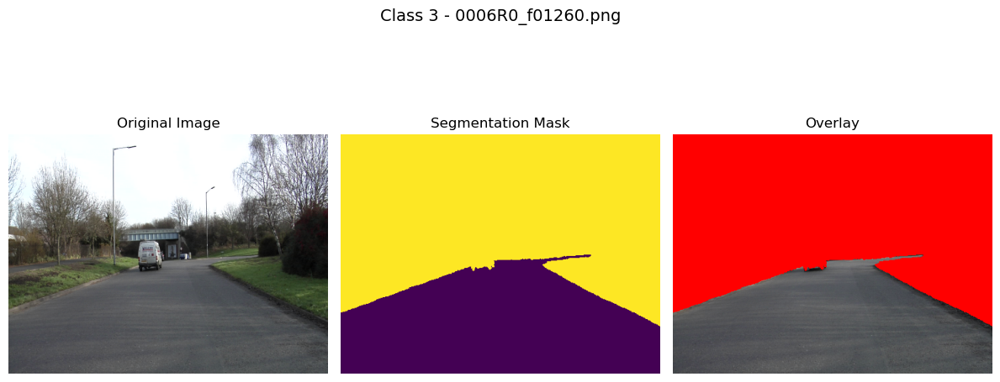

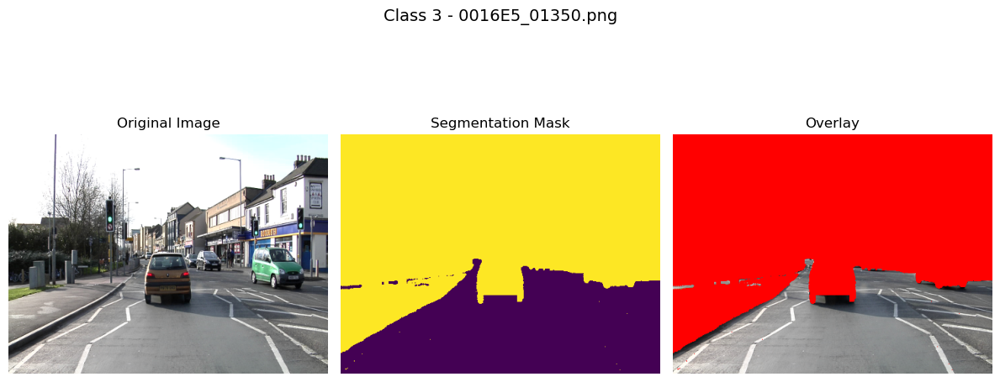

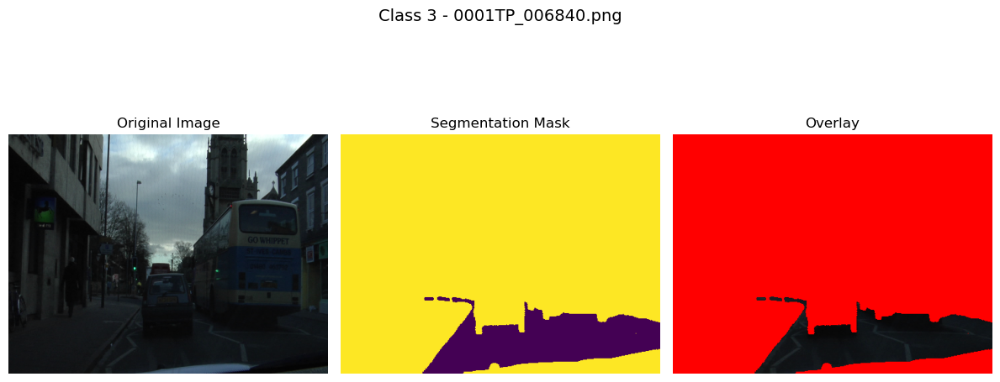

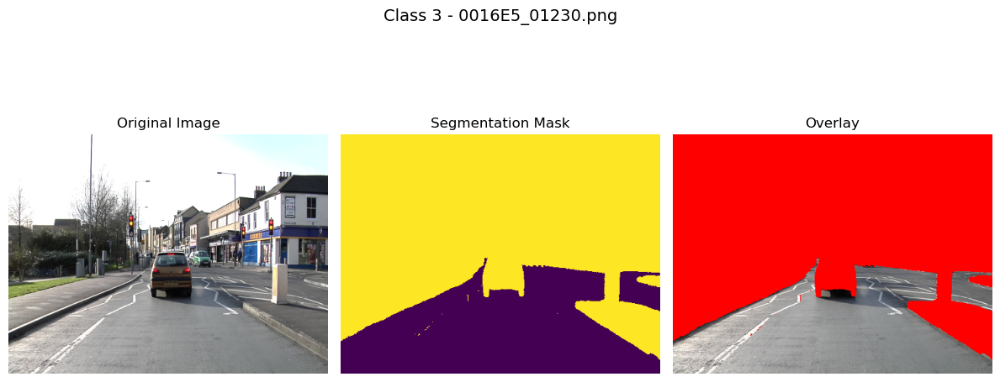

Class: 4


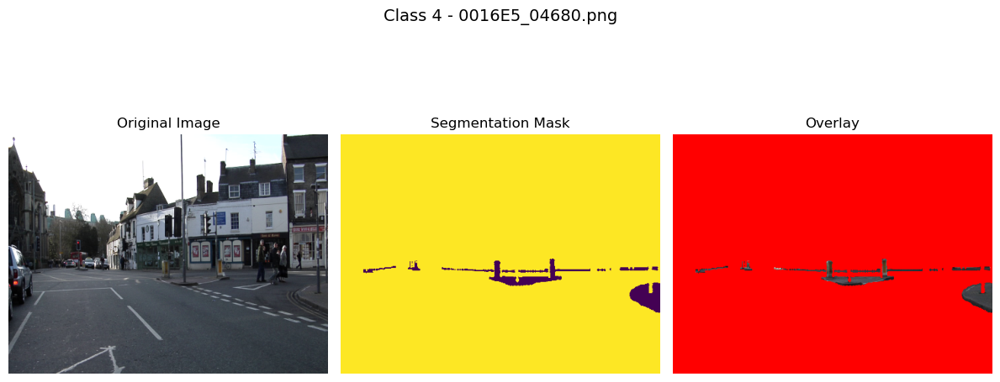

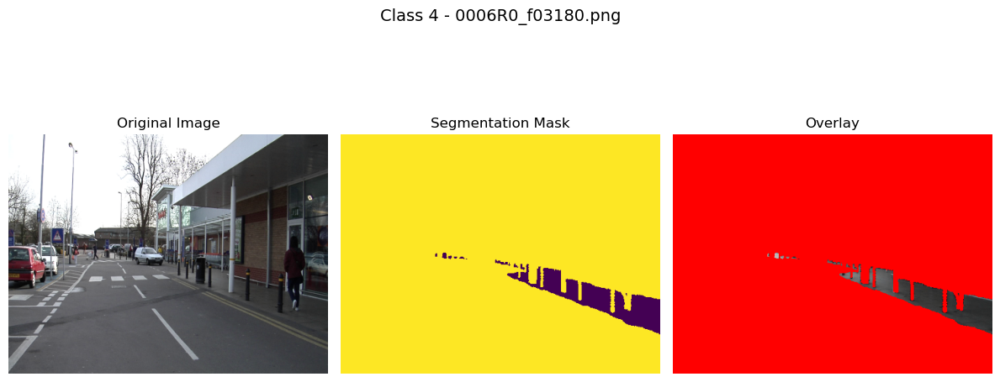

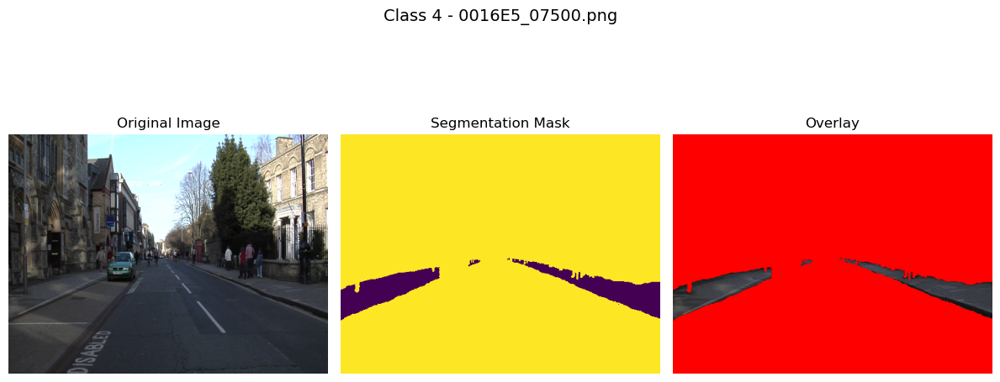

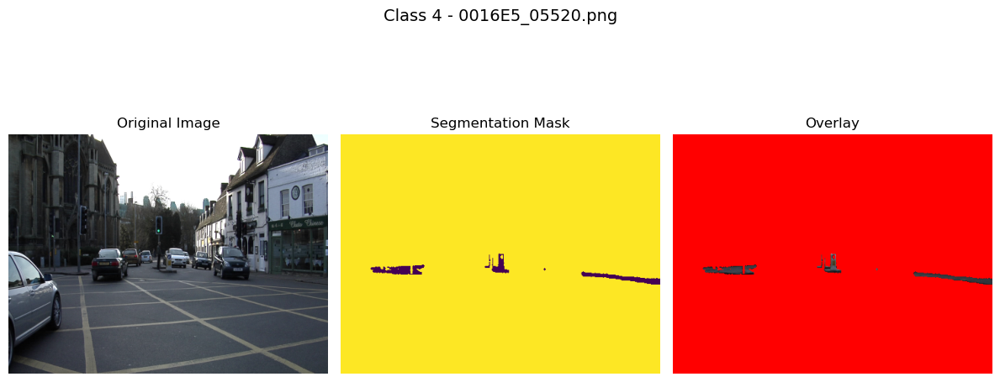

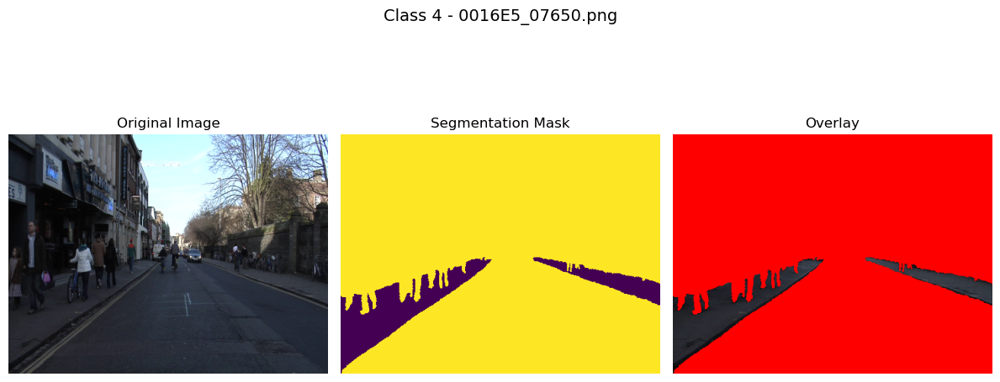

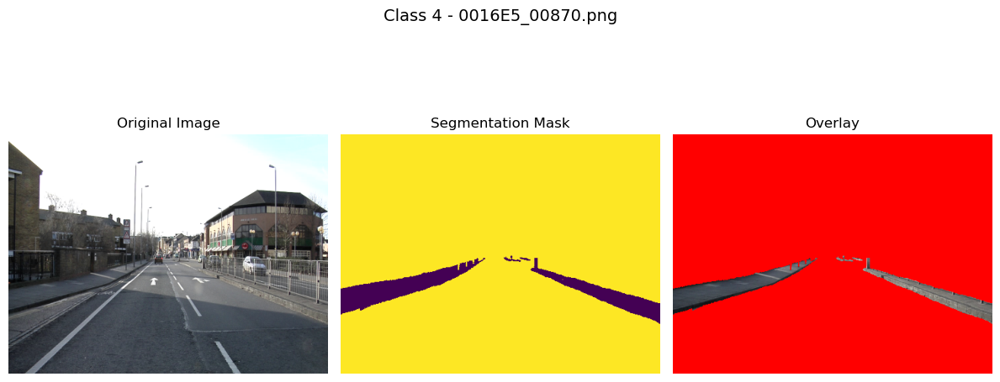

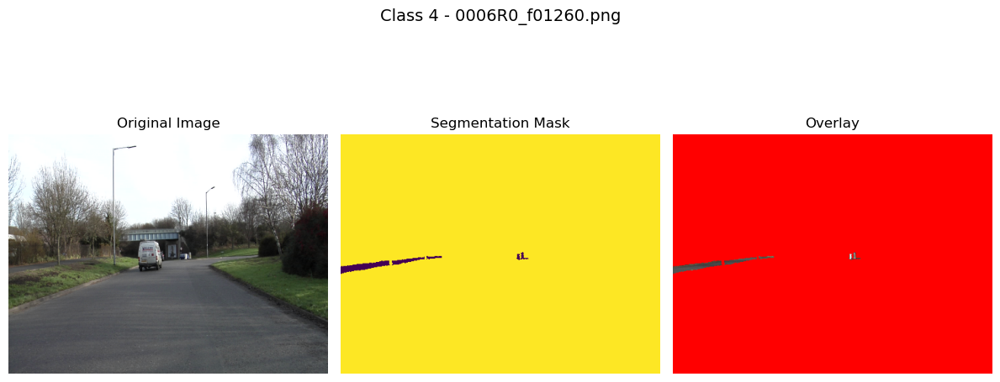

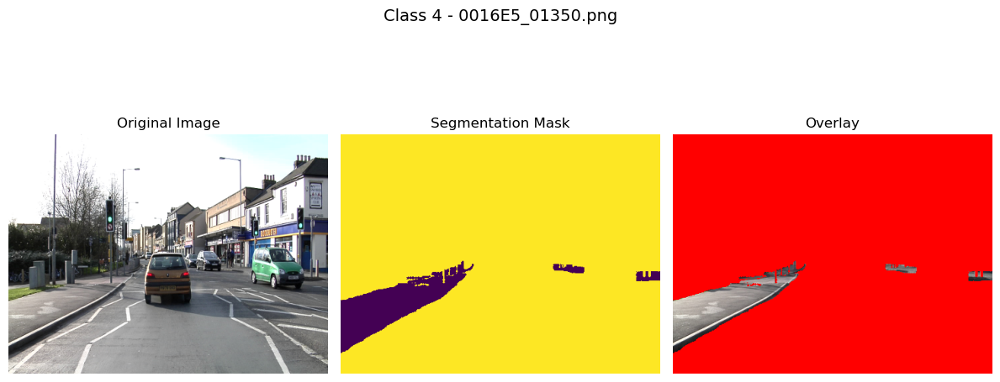

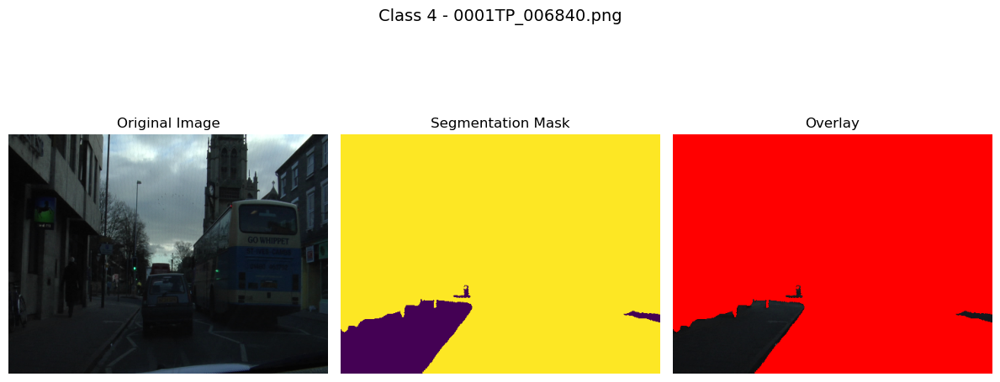

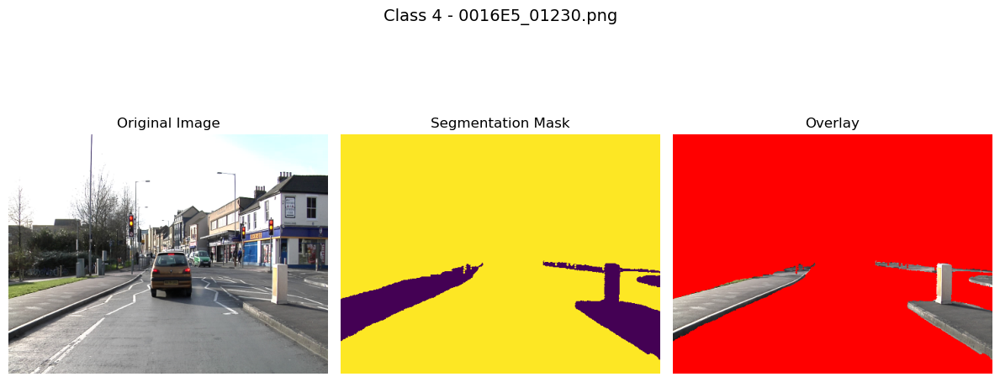

Class: 5


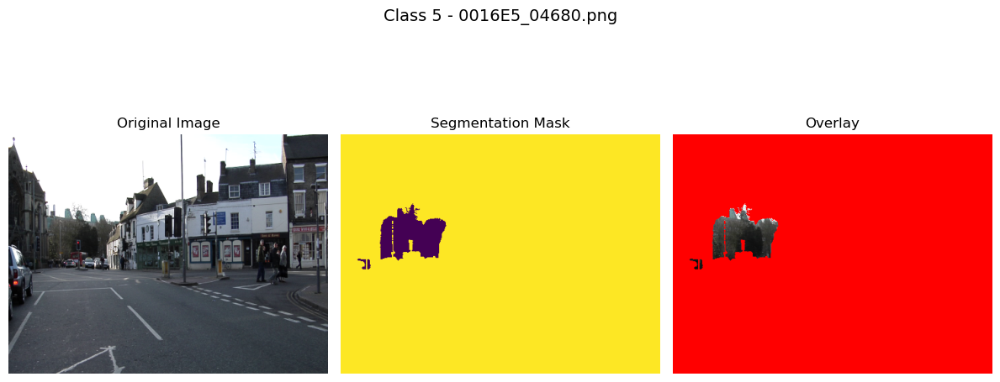

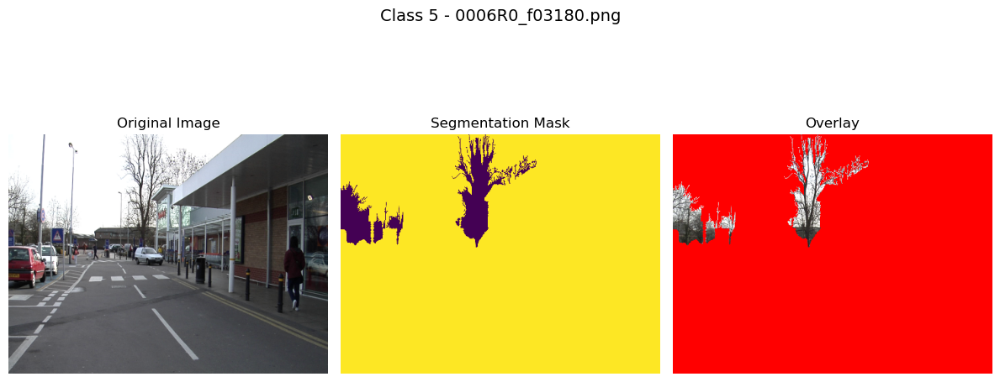

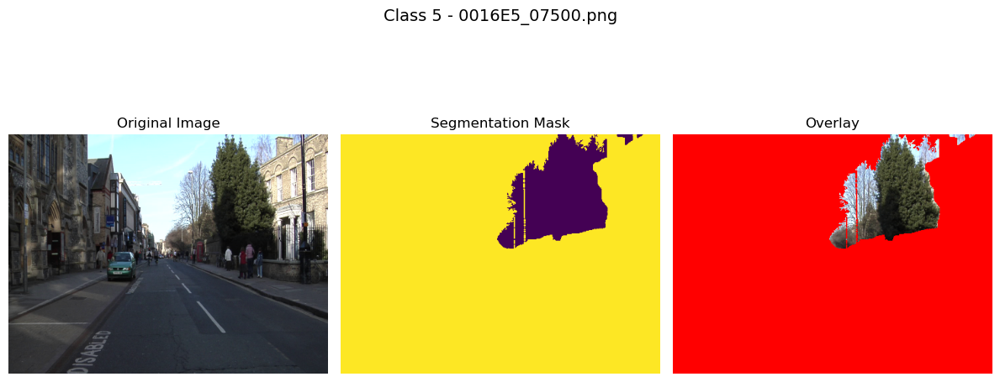

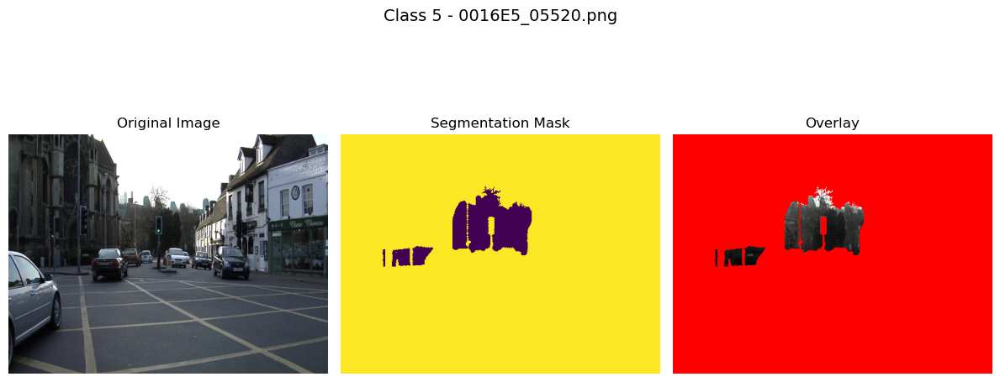

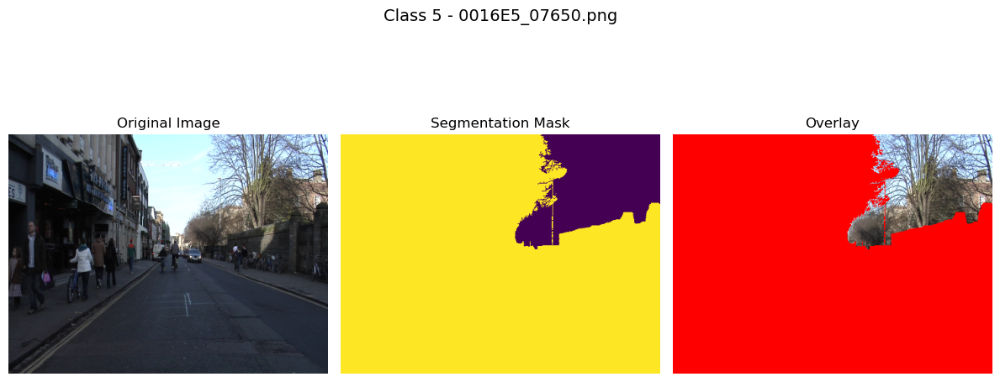

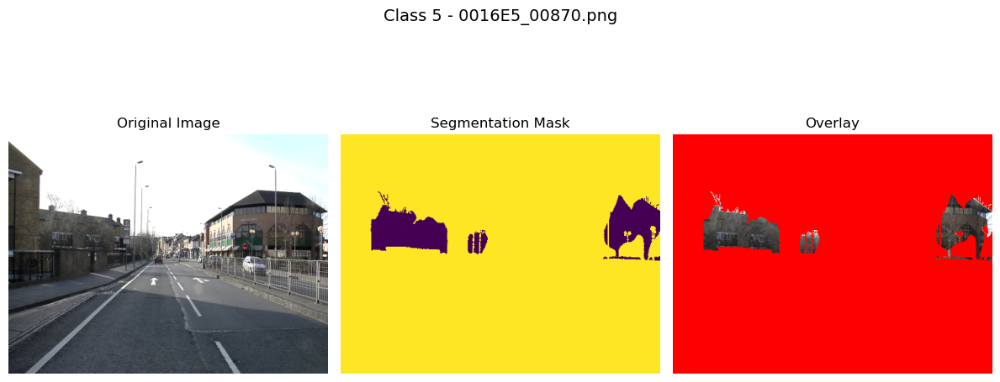

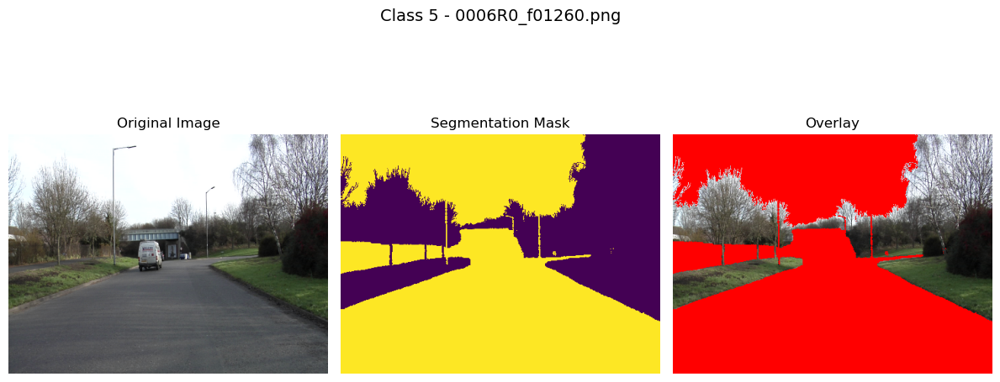

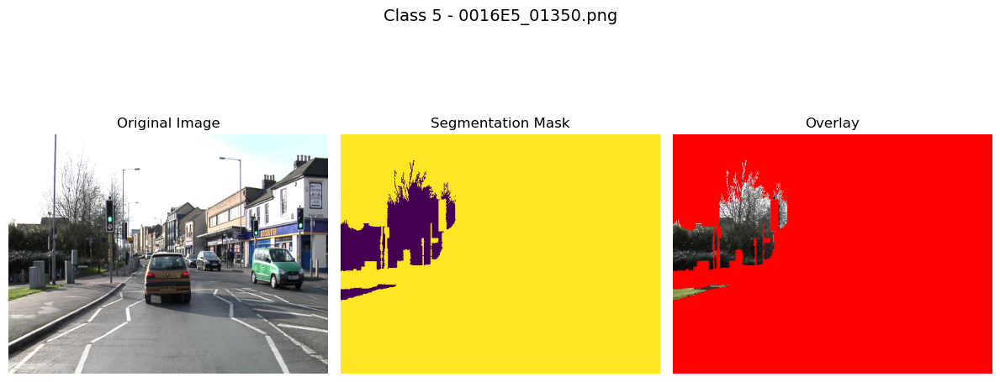

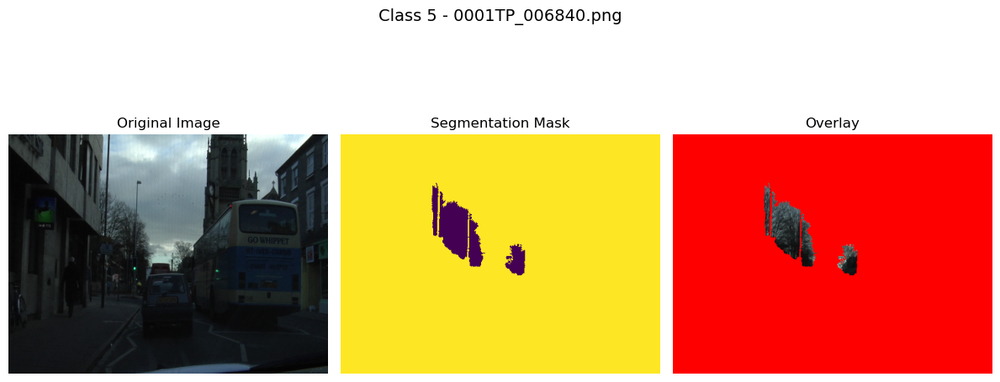

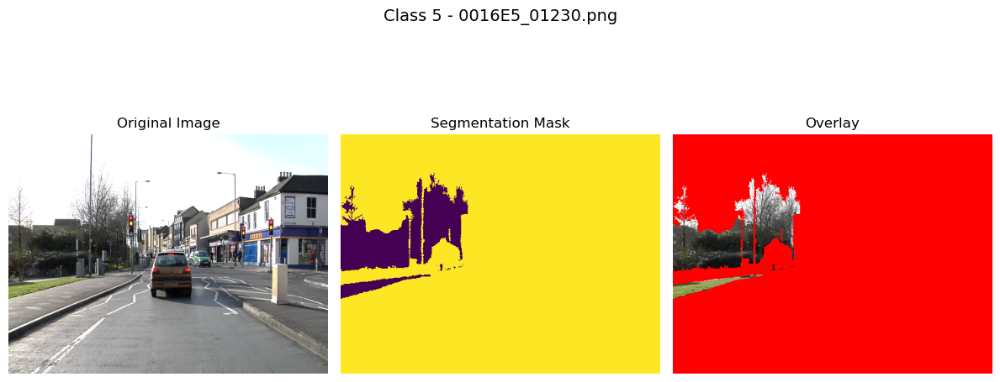

Class: 6


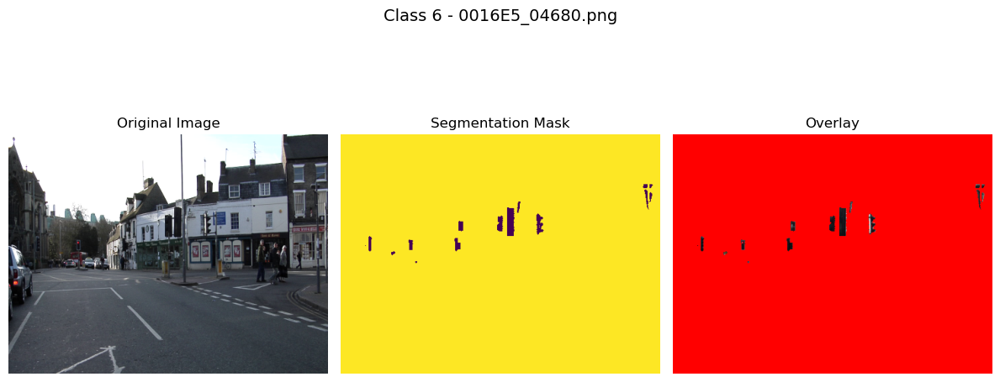

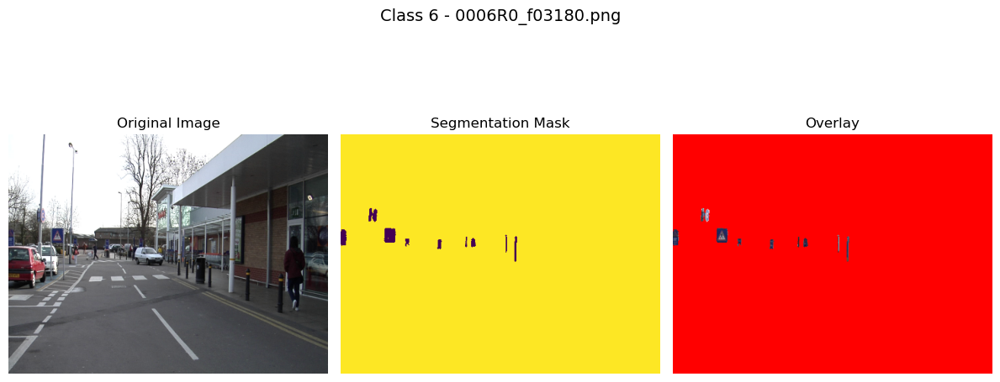

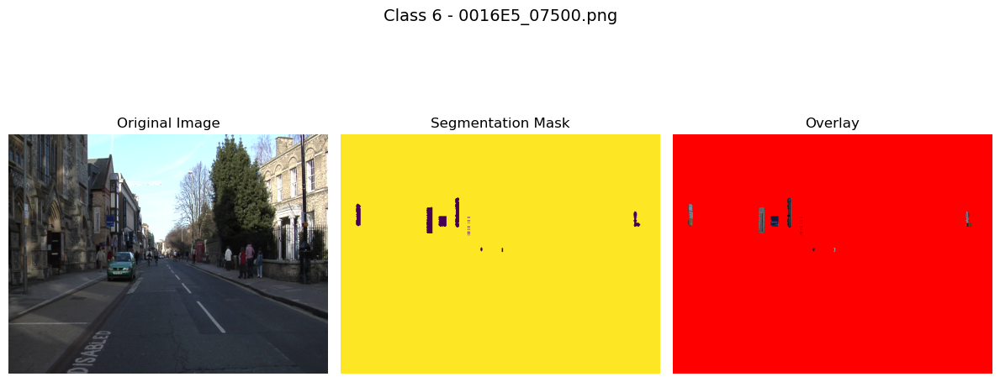

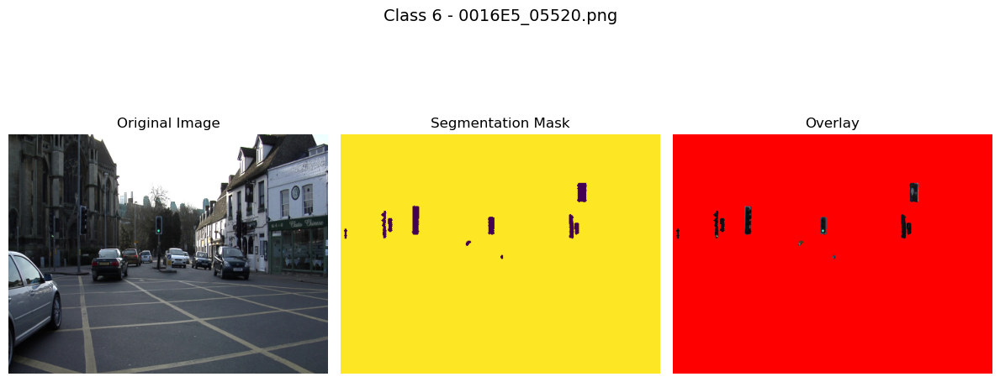

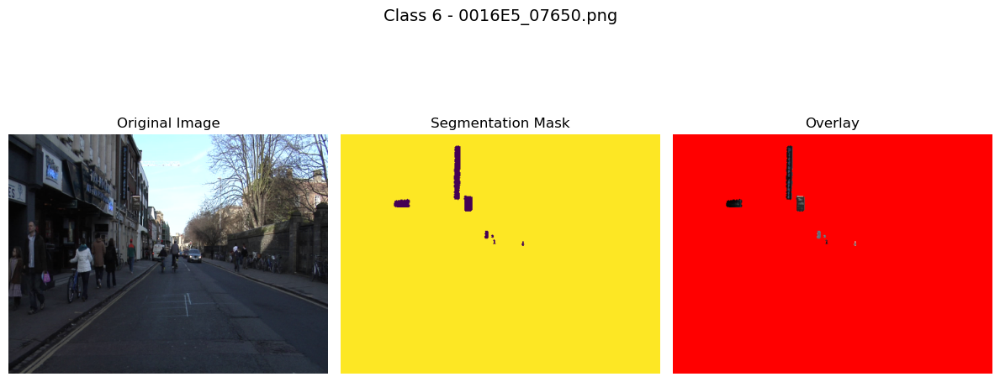

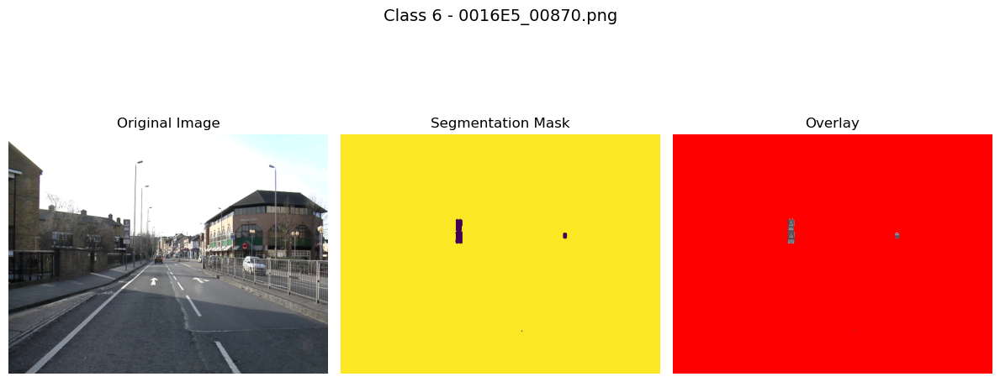

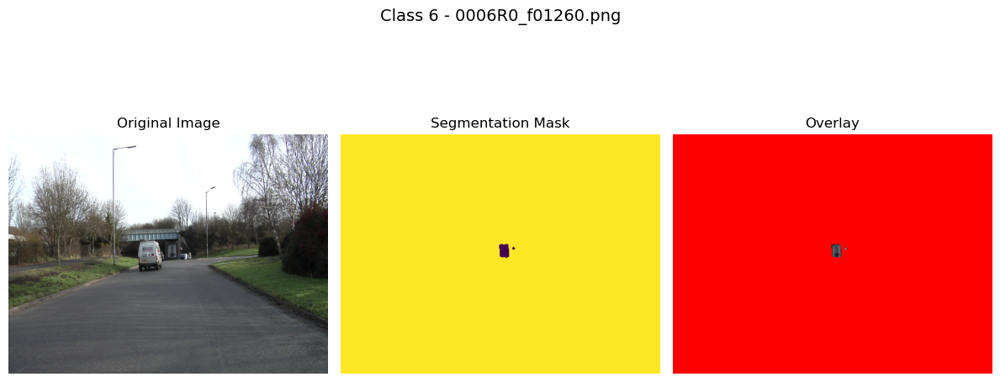

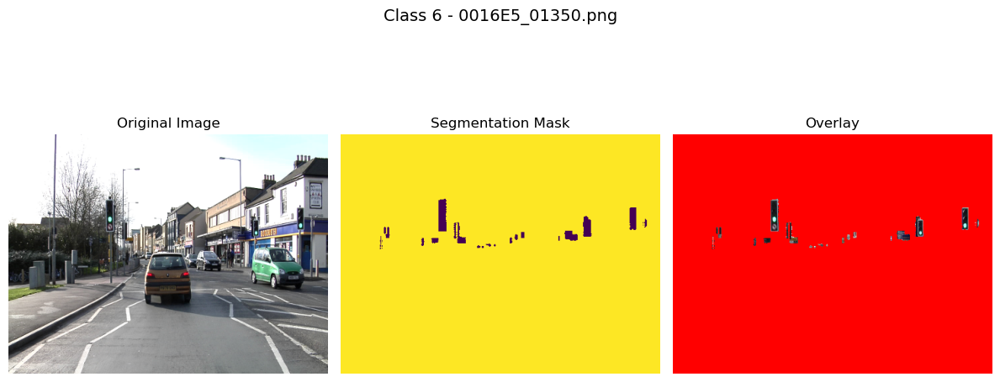

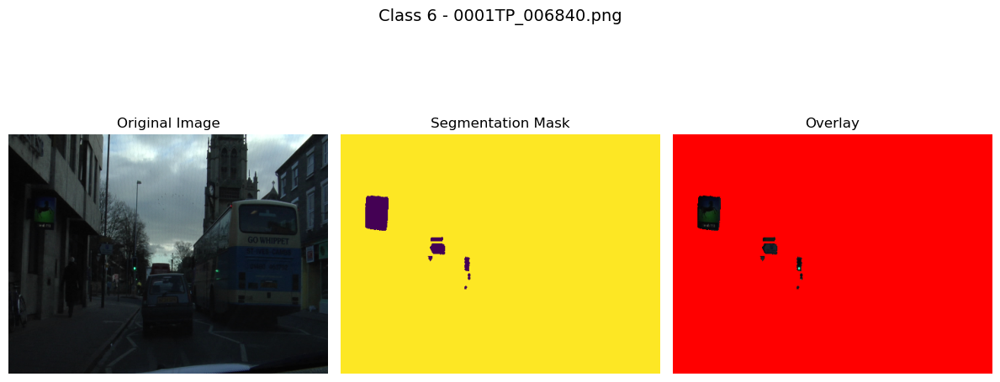

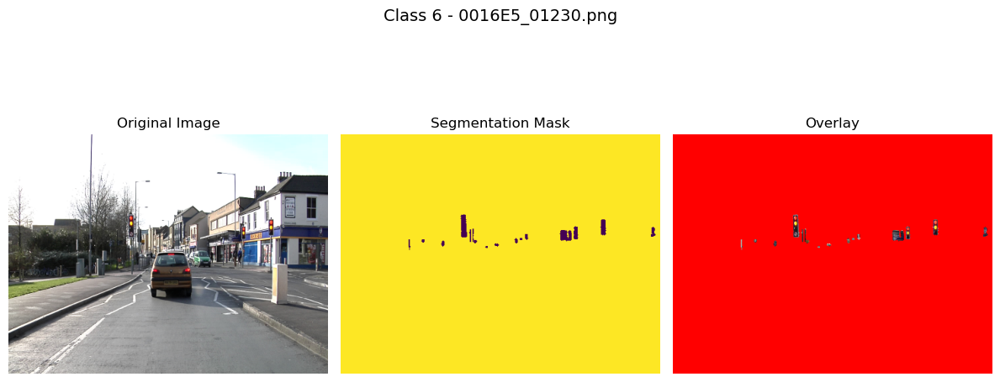

Class: 7


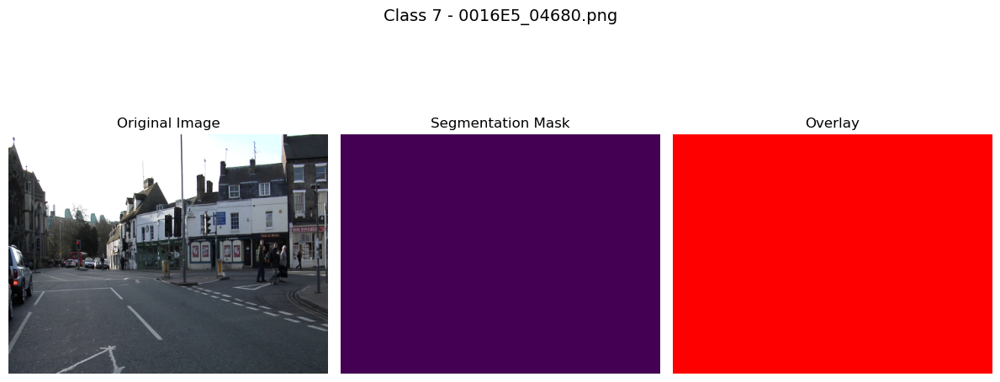

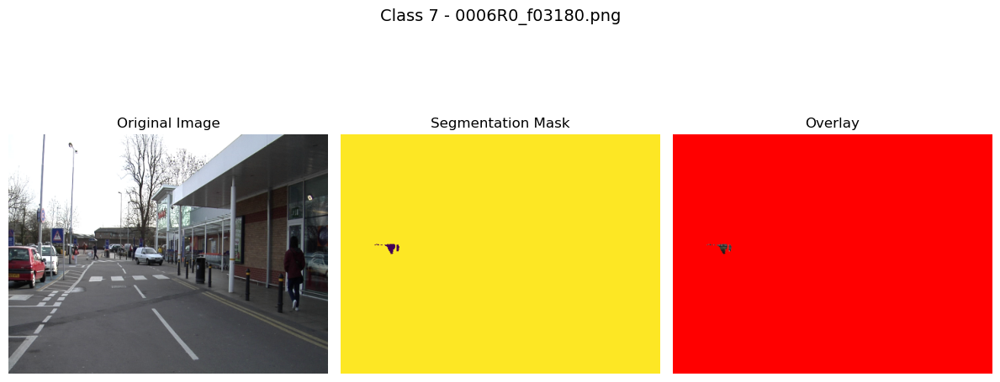

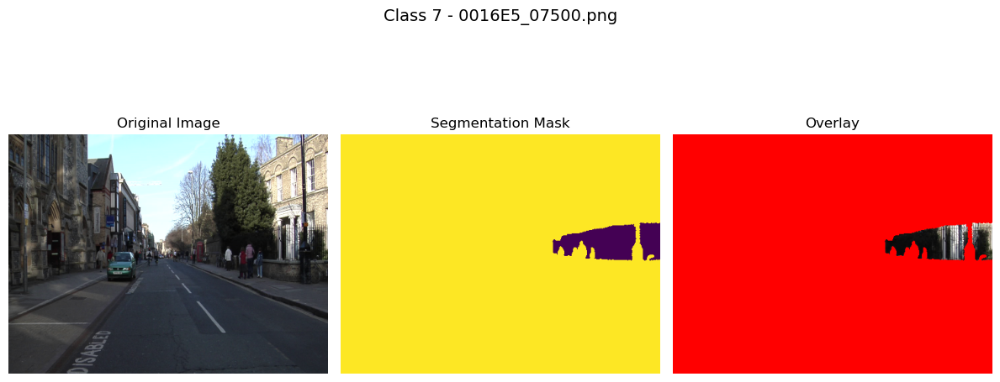

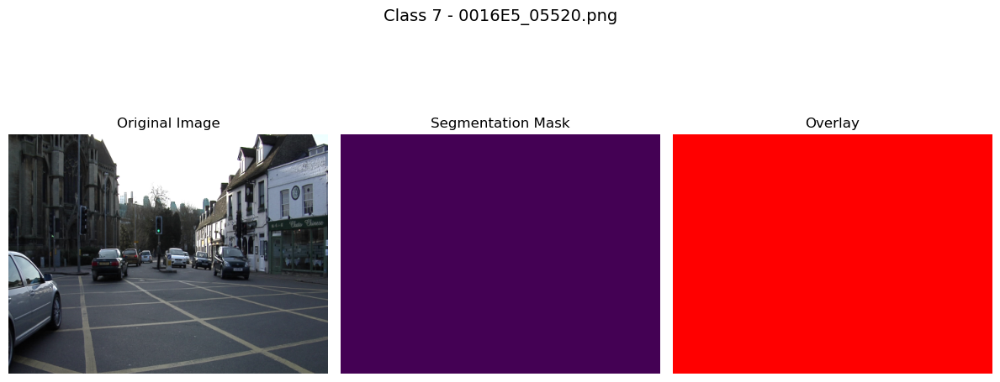

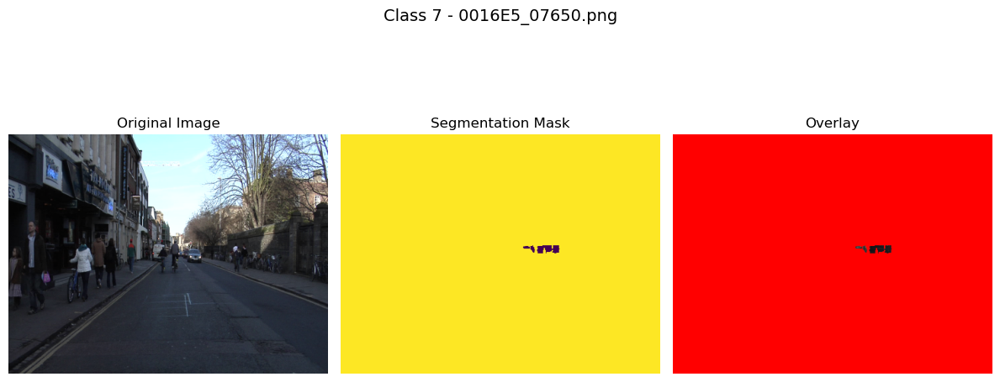

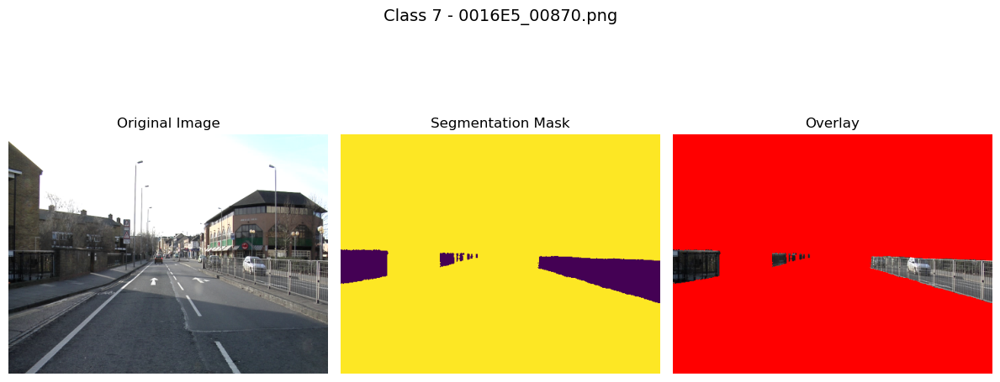

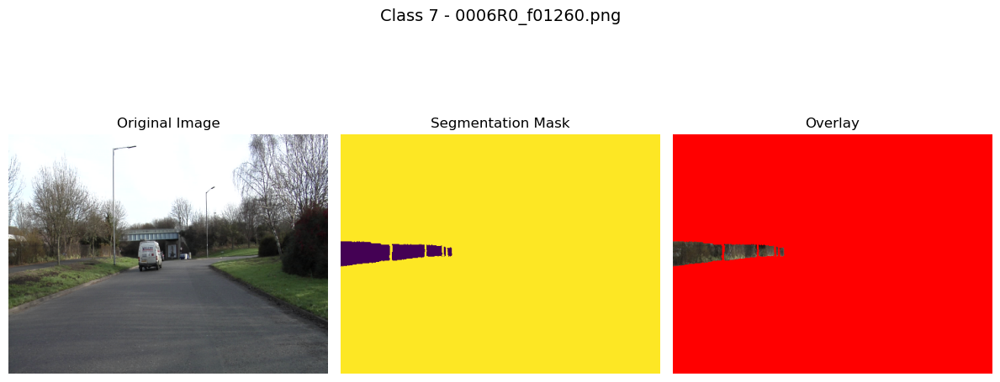

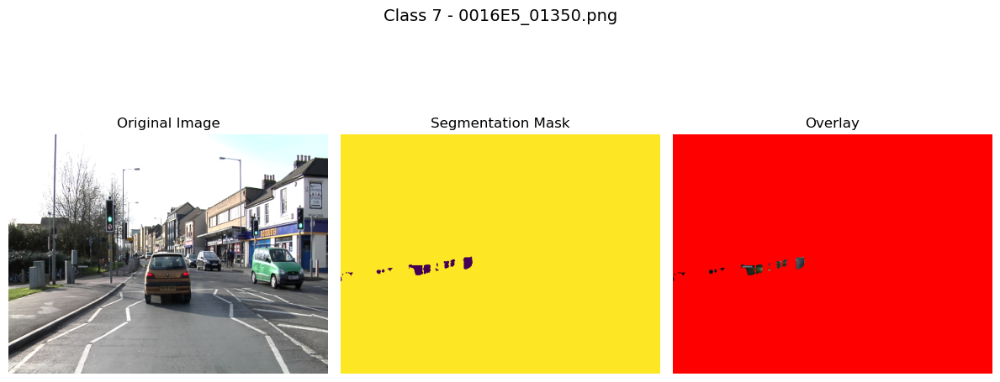

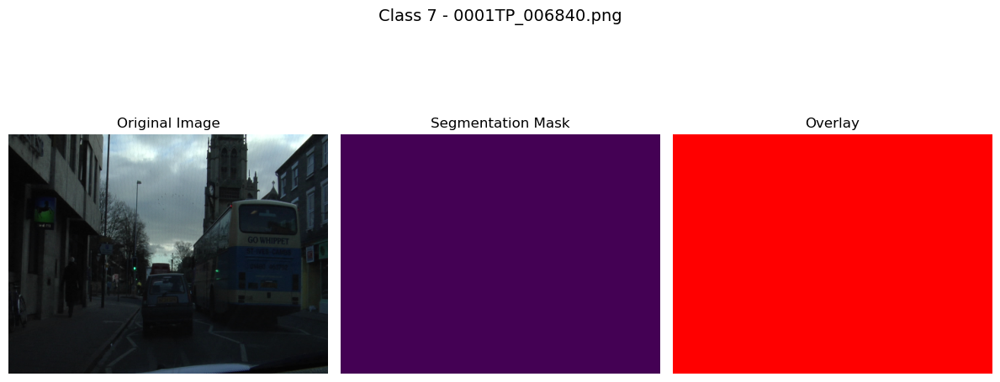

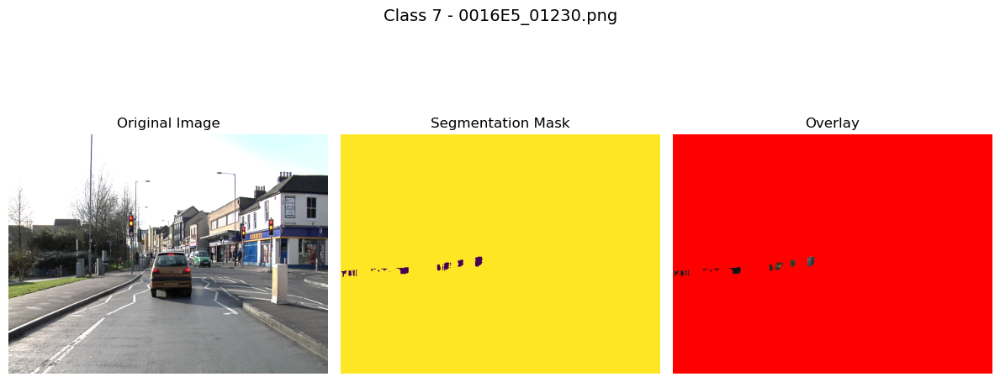

Class: 8


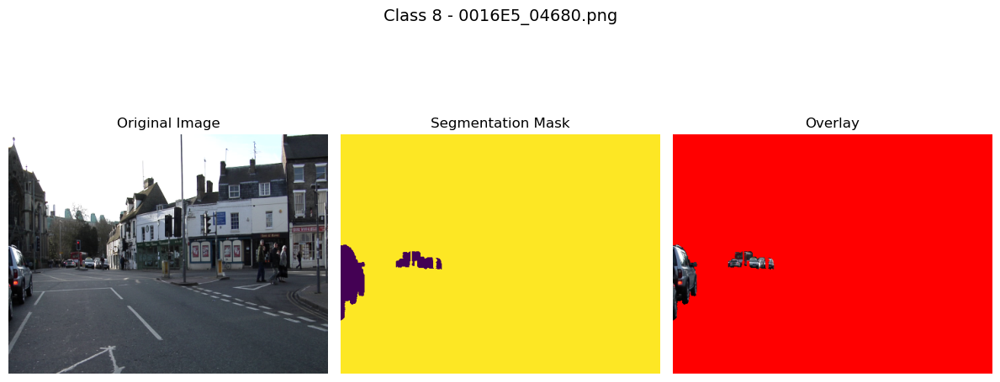

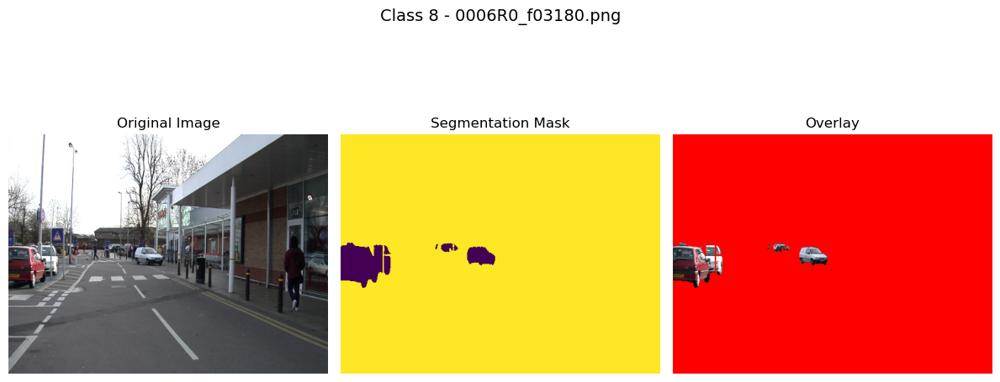

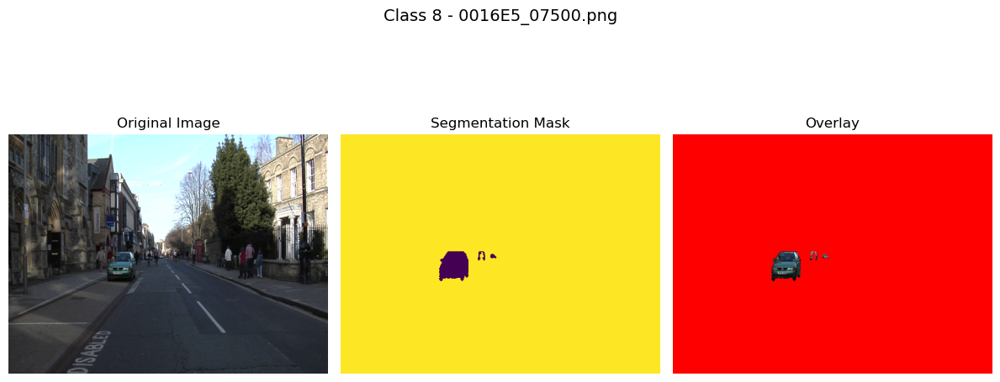

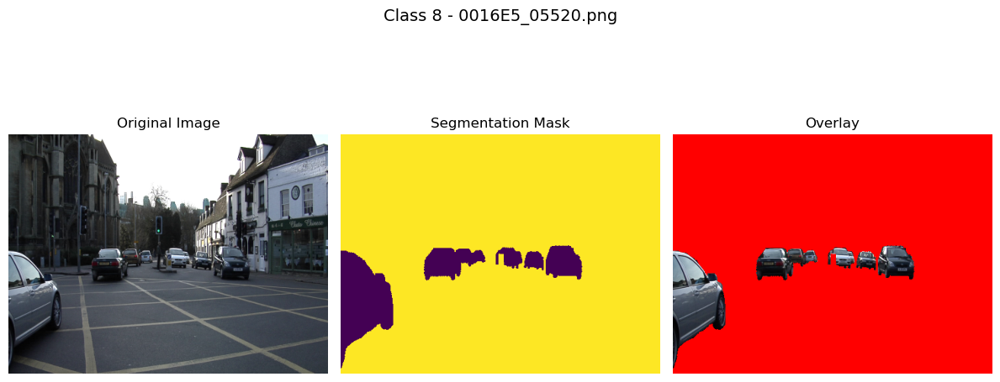

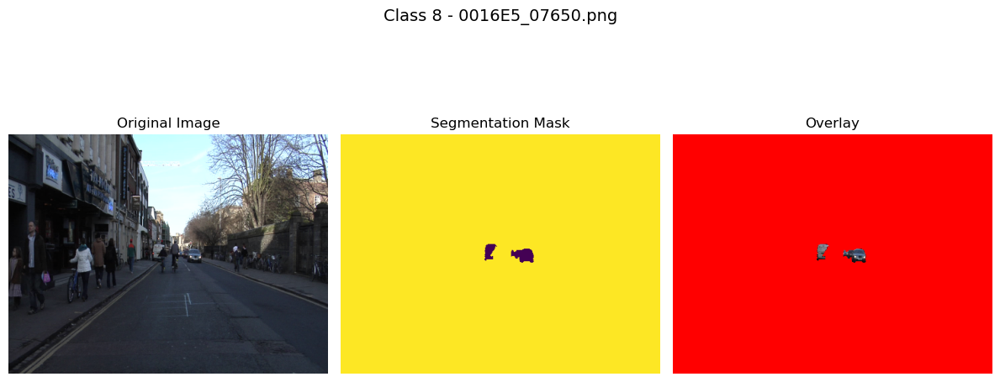

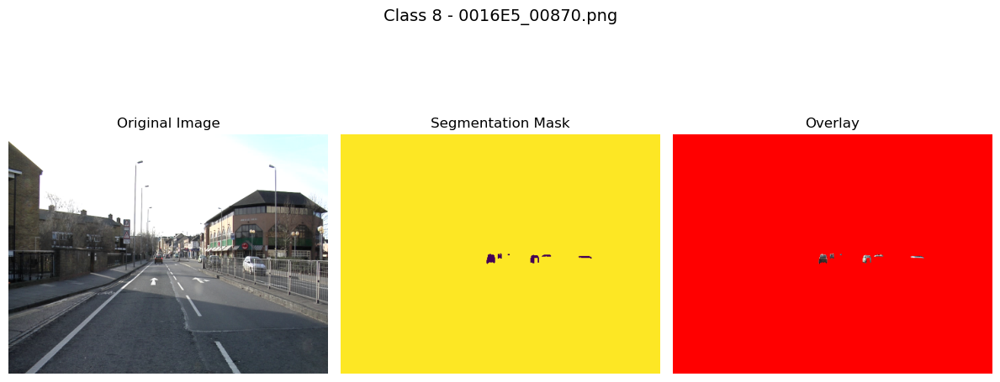

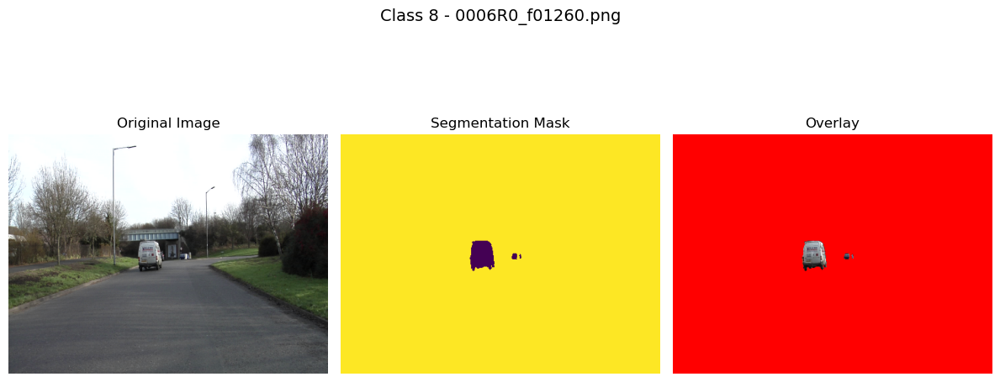

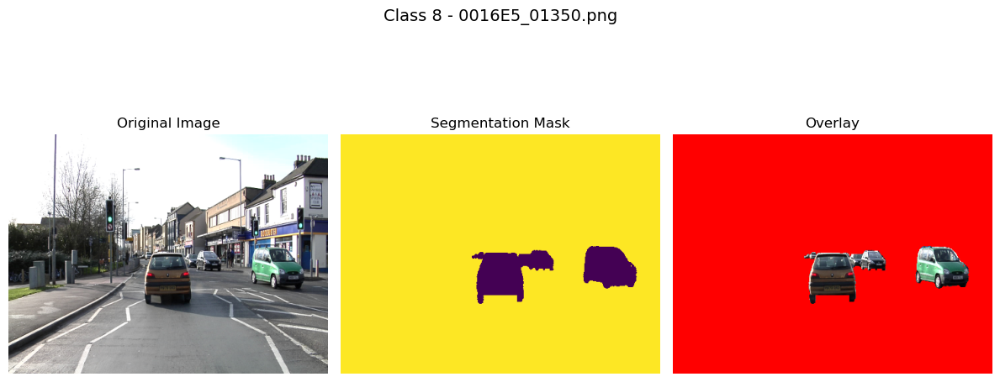

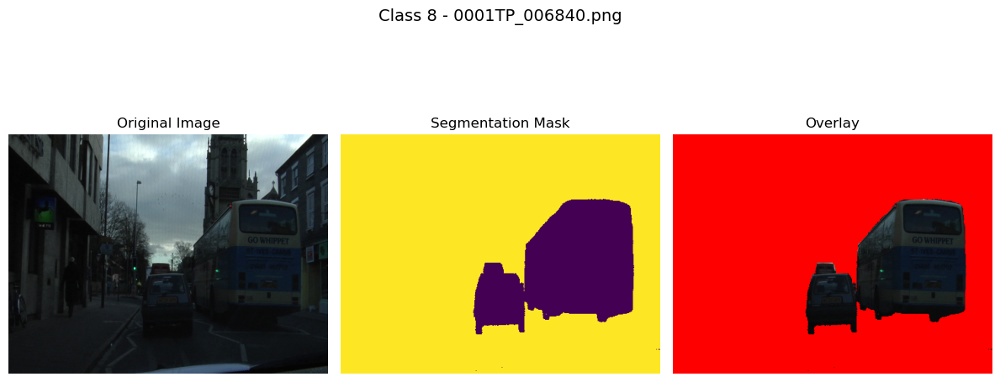

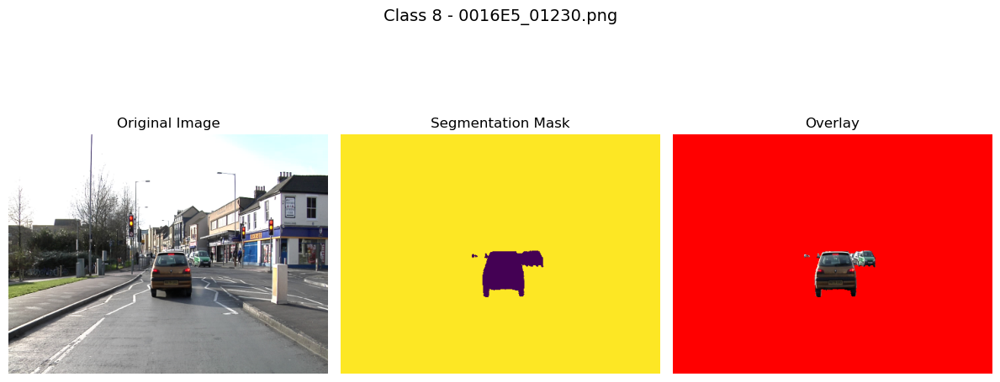

Class: 9


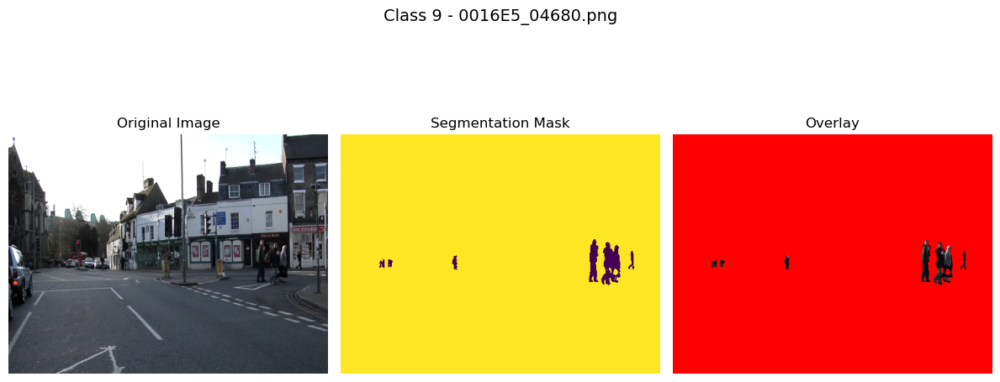

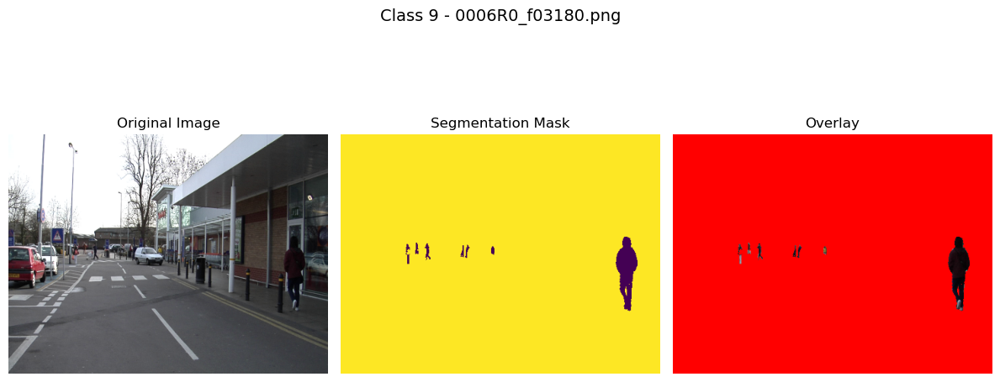

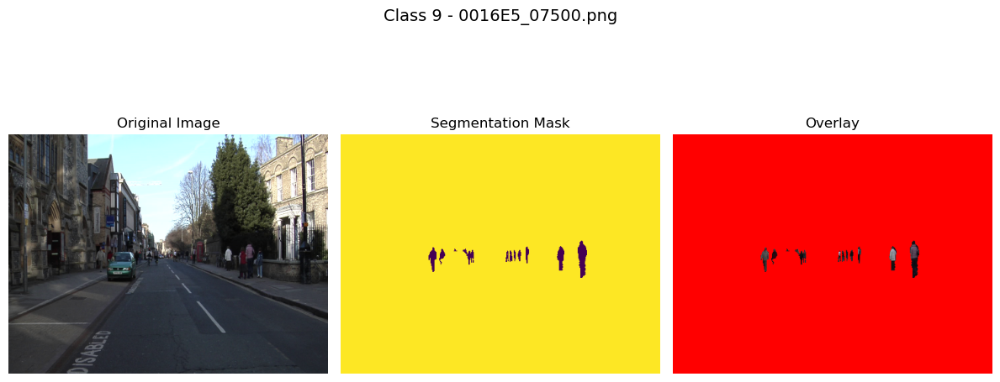

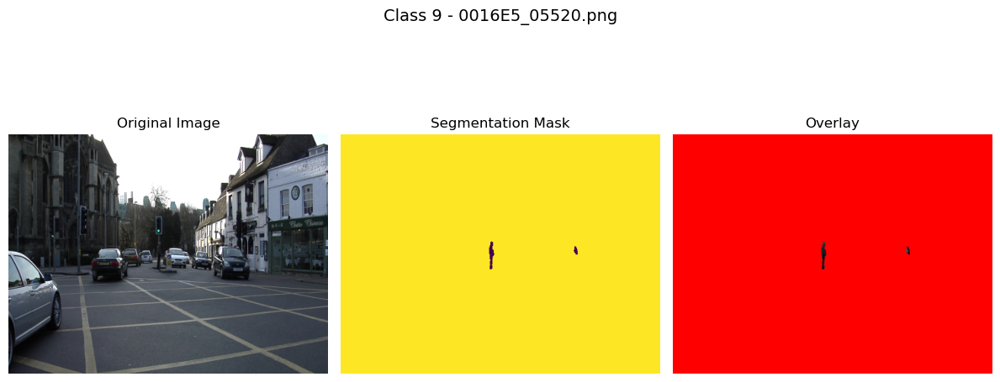

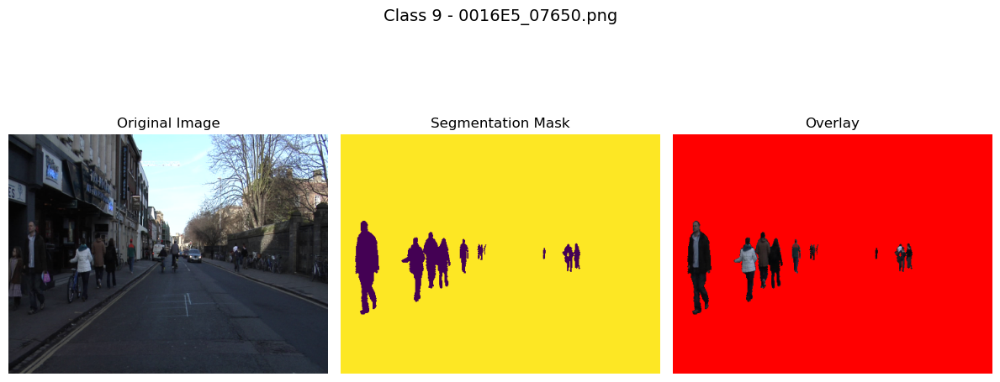

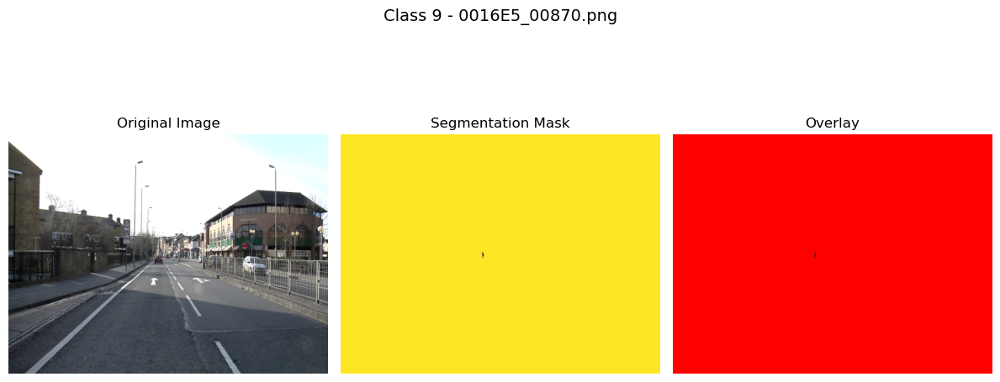

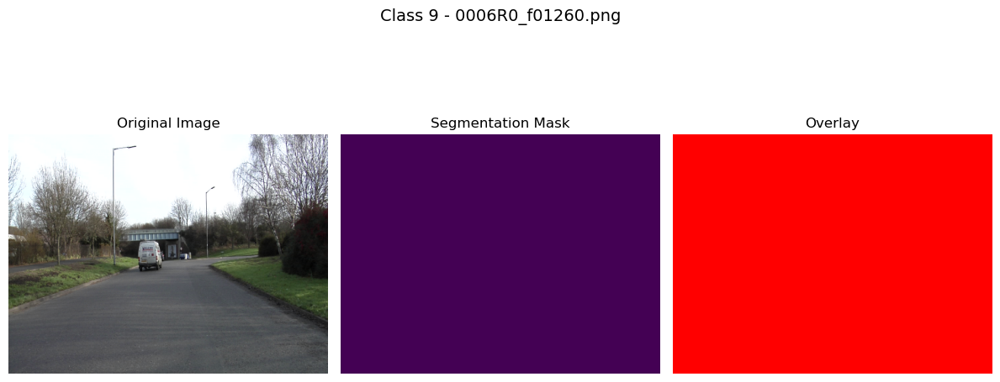

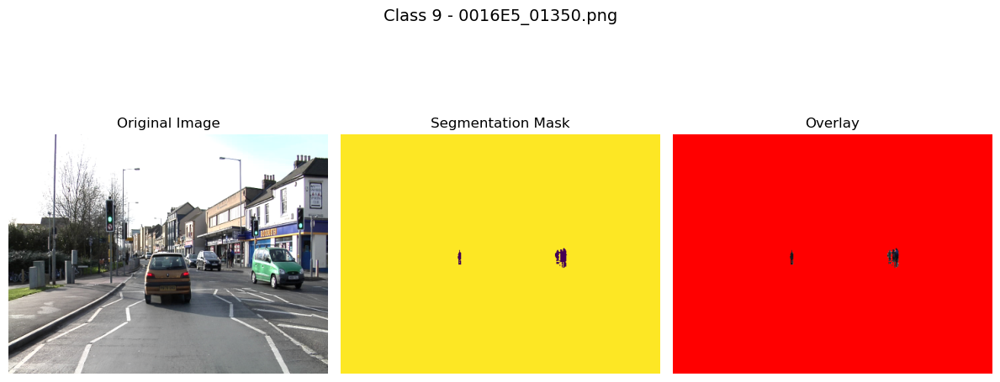

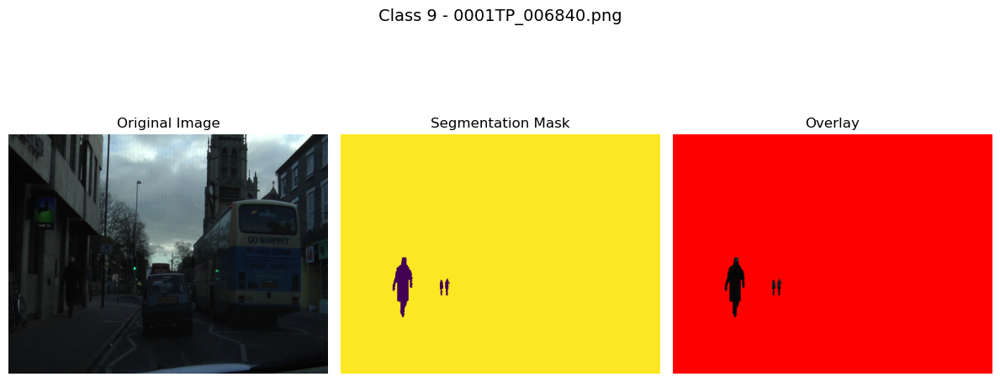

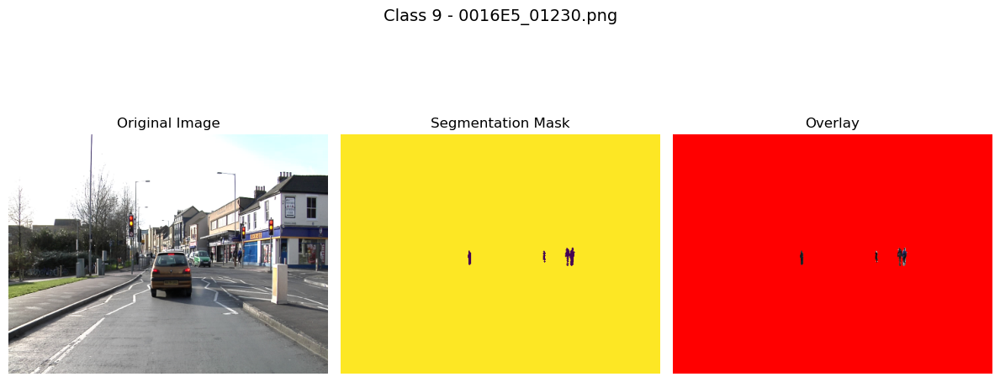

Class: 10


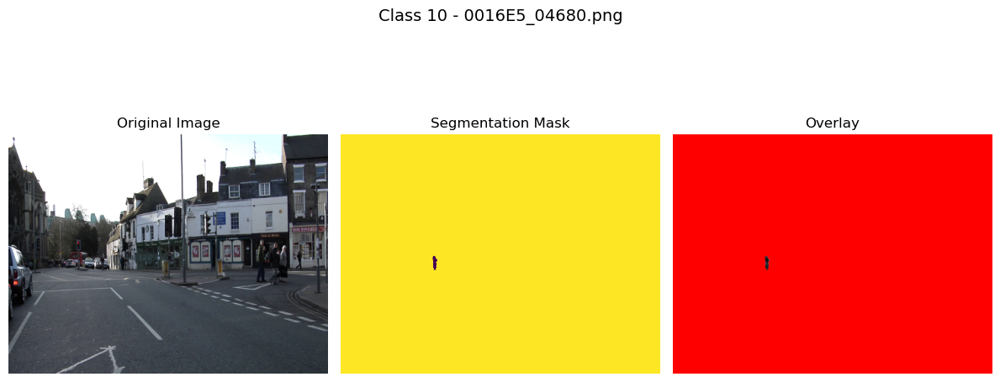

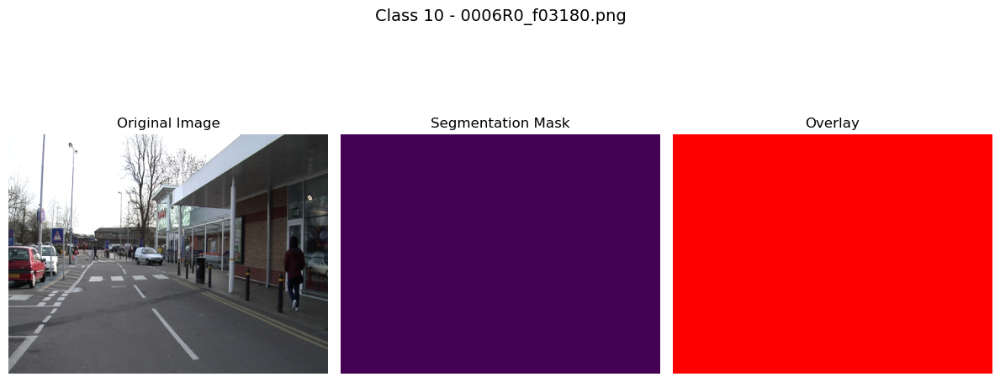

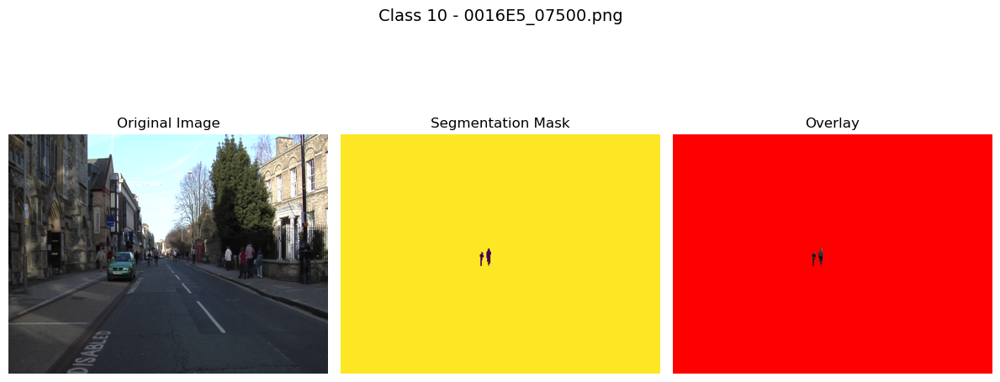

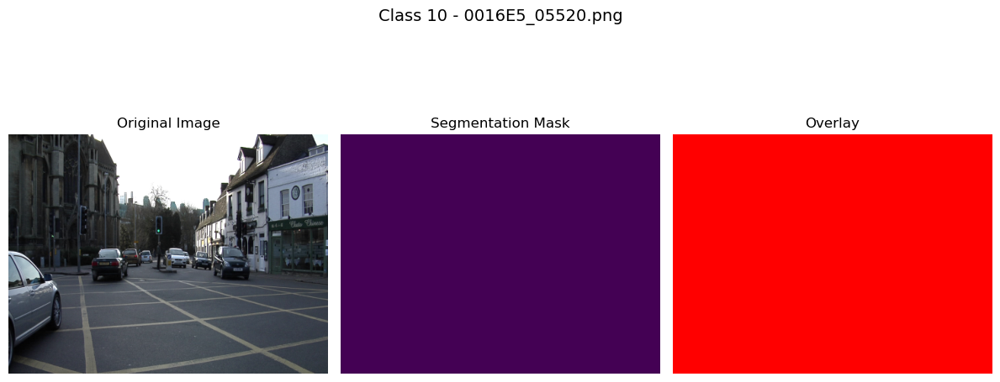

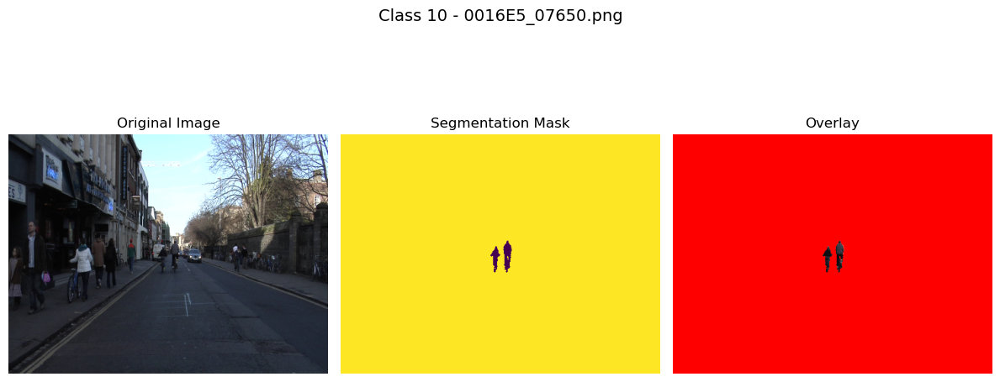

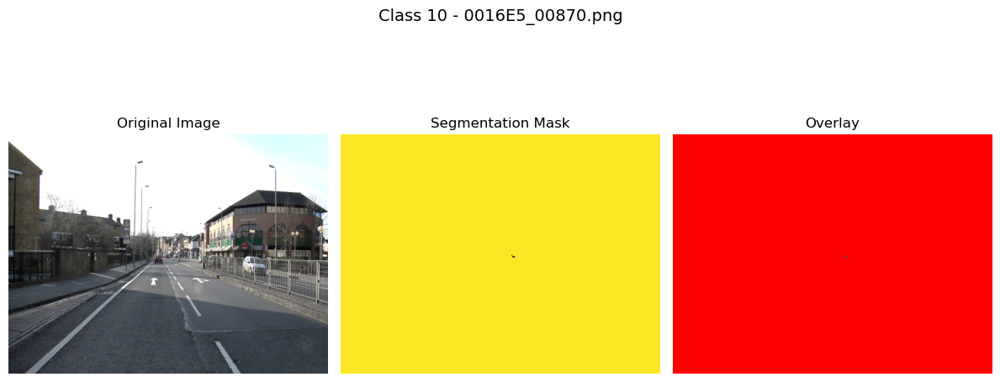

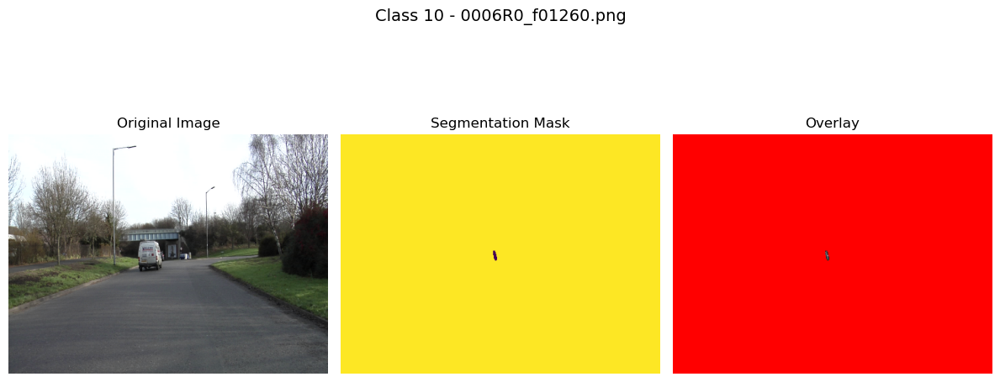

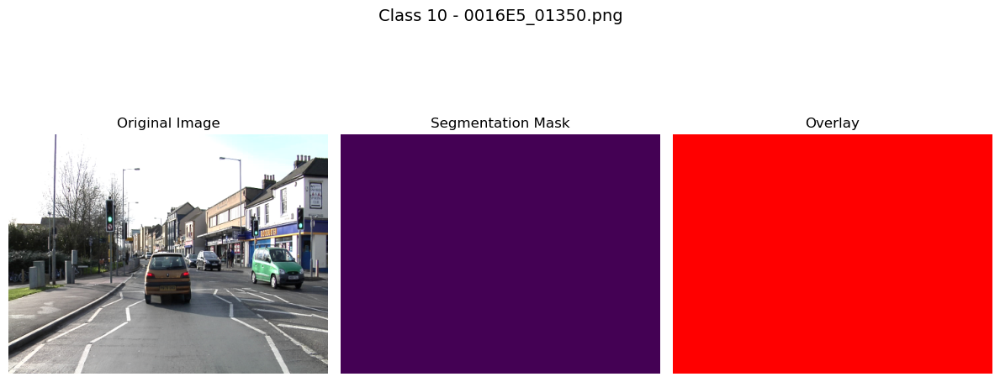

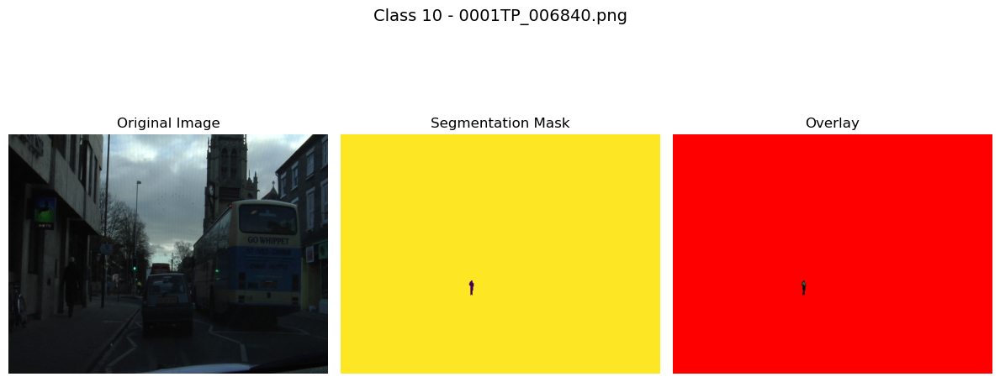

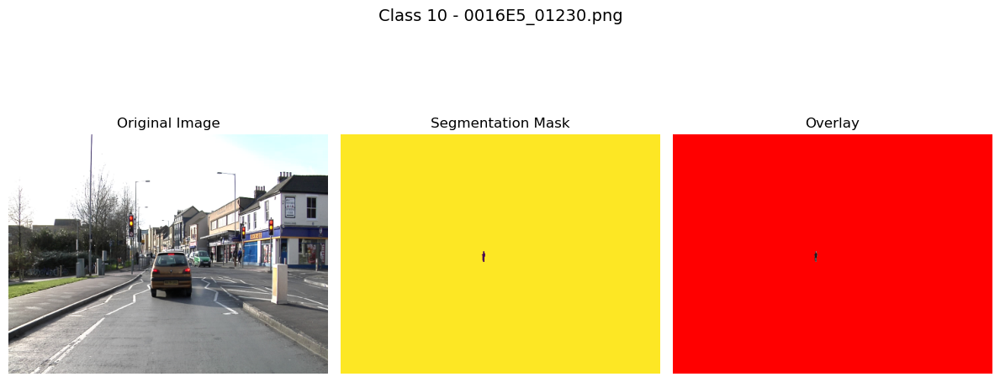

Class: 11


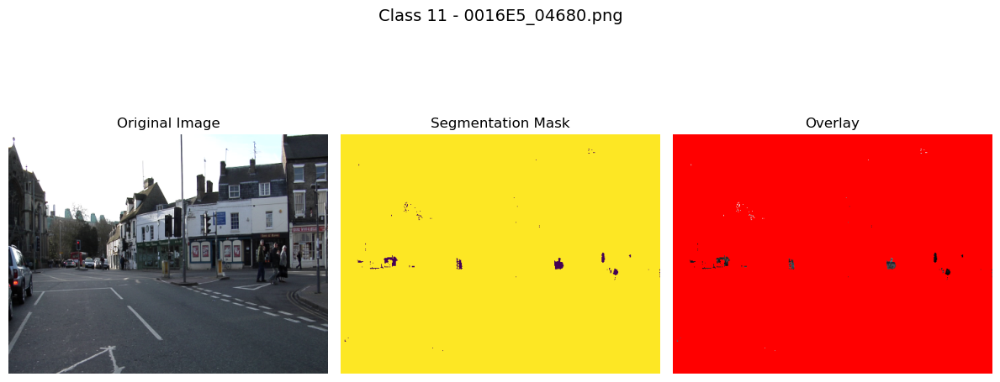

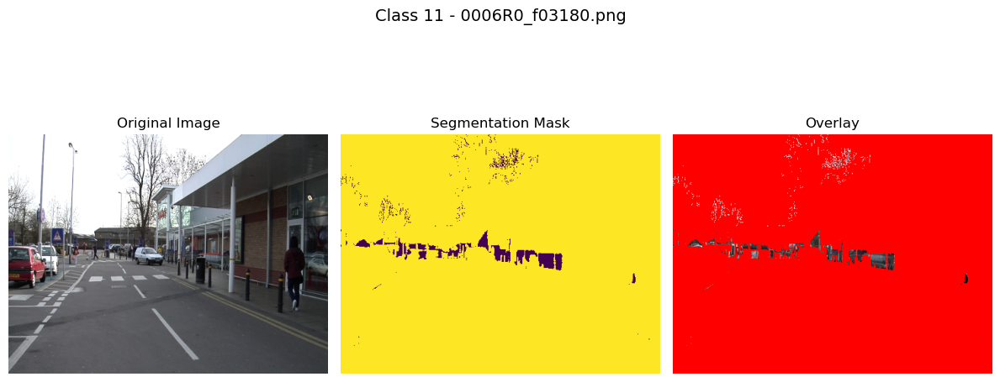

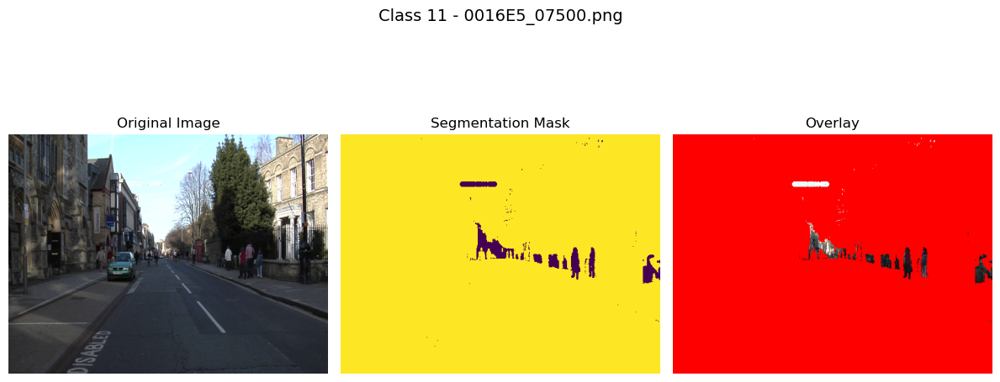

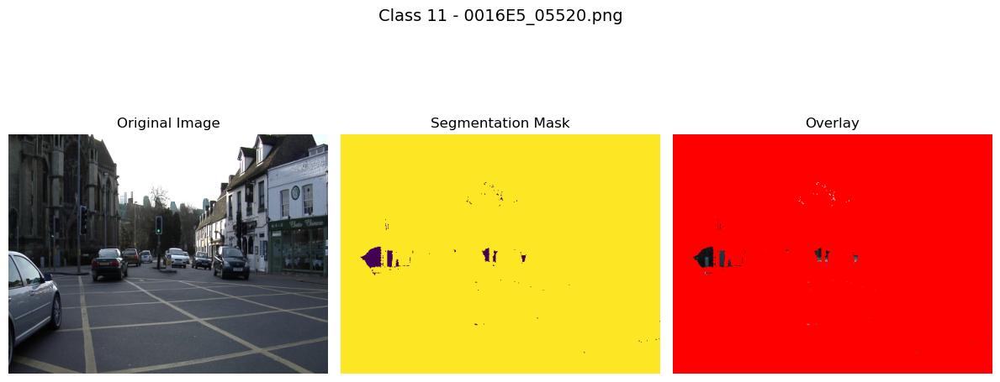

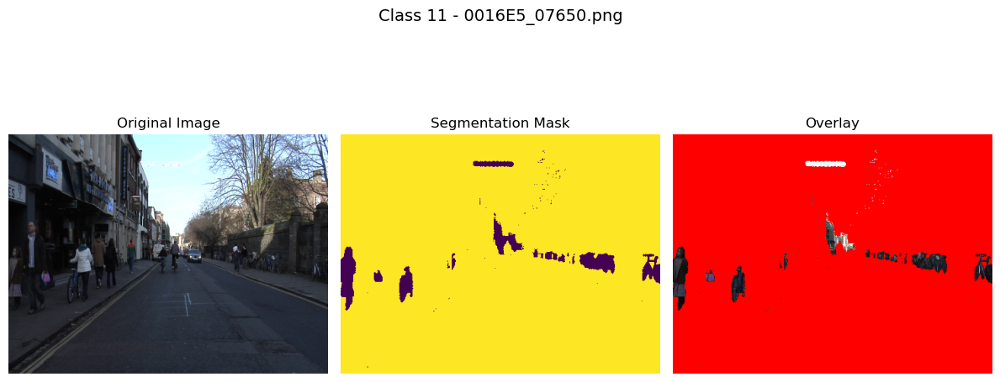

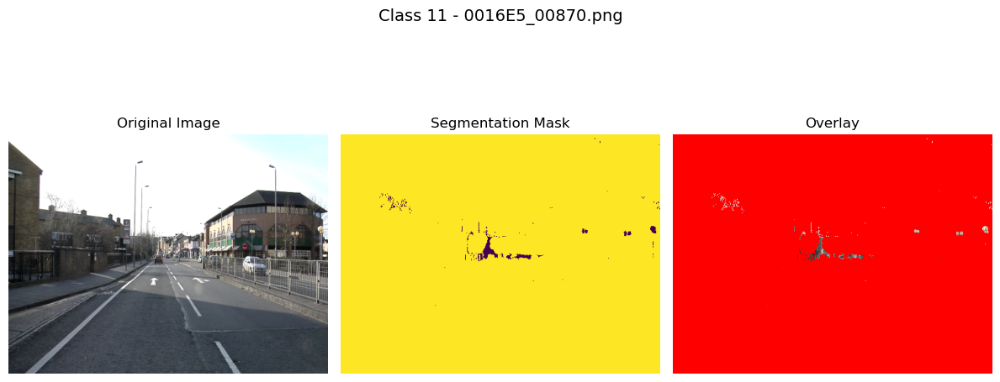

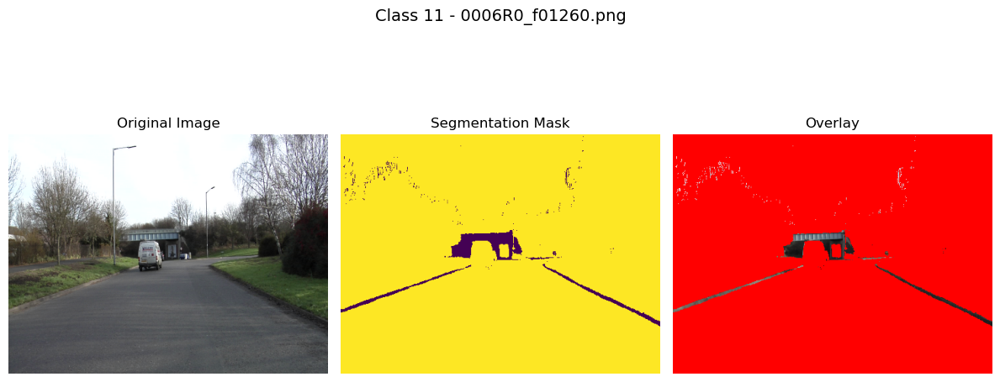

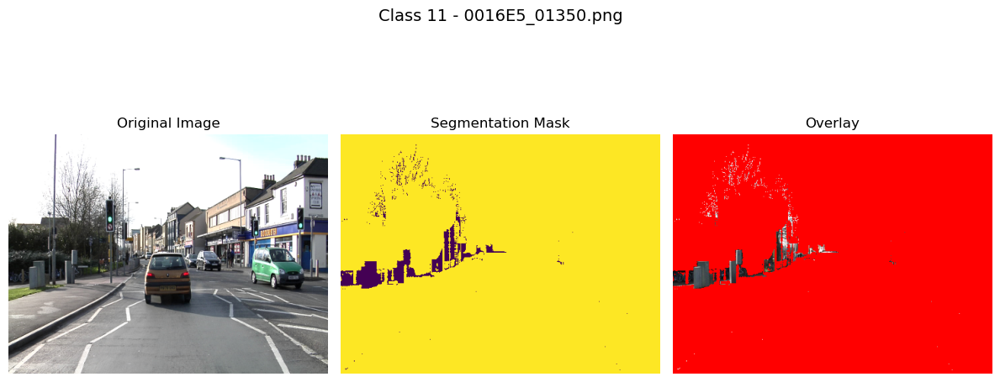

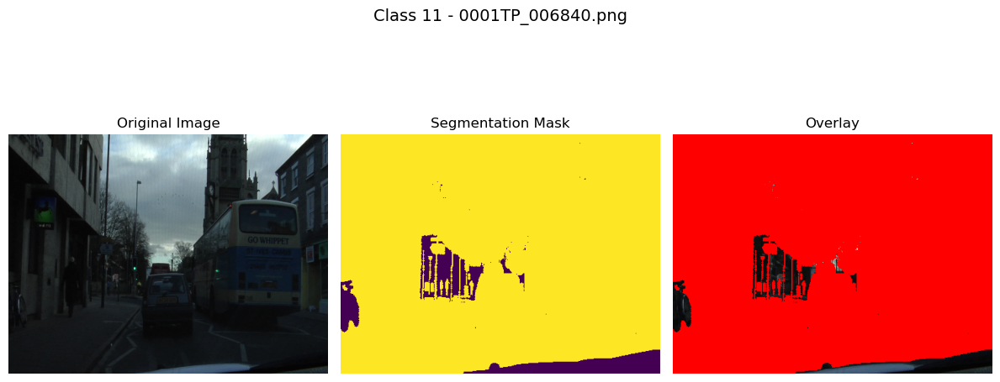

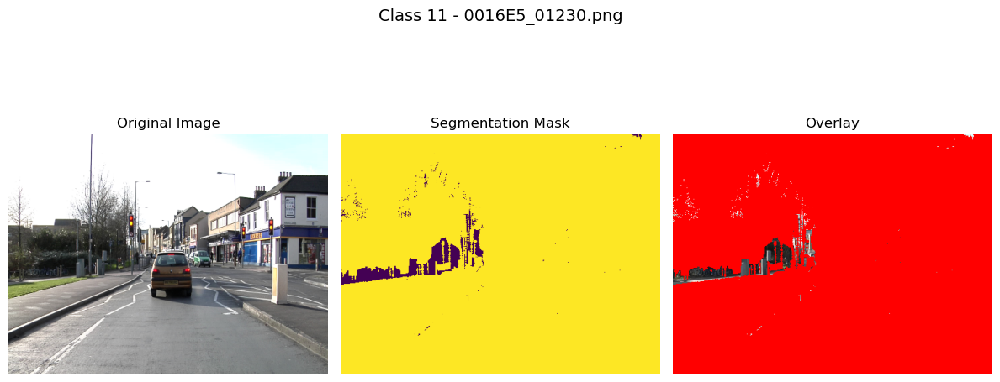

In [38]:
for key in sorted(classes_dict):
   print(f"Class: {key}")
   for file in show_files:
     show(os.path.join(TRAIN_IMG_PATH, file), os.path.join(TRAIN_MASK_PATH, file), show_classes=[key],
          img_mode=img_mode, mask_mode=mask_mode, void_color=[255,0,0], title=f"Class {key} - {file}")


## Save EDA result for Training part

In [39]:
classes = sorted(classes_dict)
classes_df = pd.DataFrame(classes, columns=['class'])

label_map = {
    0: 'sky',
    1: 'building',
    2: 'pole',
    3: 'road',
    4: 'sidewalk',
    5: 'vegetation',
    6: 'traffic sign',
    7: 'fence',
    8: 'vehicle',
    9: 'person',
    10: 'rider',
    11: 'void'
}
classes_df['label'] = classes_df['class'].map(label_map)
print(classes_df)
classes_df.to_csv(EDA_TRAIN_LABELS, index=False)

    class         label
0       0           sky
1       1      building
2       2          pole
3       3          road
4       4      sidewalk
5       5    vegetation
6       6  traffic sign
7       7         fence
8       8       vehicle
9       9        person
10     10         rider
11     11          void


In [40]:
files_df = pd.DataFrame(files, columns=['filename'])
print(files_df)
files_df.to_csv(EDA_TRAIN_FILES, index=False)

              filename
0    0001TP_006690.png
1    0001TP_006720.png
2    0001TP_006750.png
3    0001TP_006780.png
4    0001TP_006810.png
..                 ...
362   0016E5_08520.png
363   0016E5_08550.png
364   0016E5_08580.png
365   0016E5_08610.png
366   0016E5_08640.png

[367 rows x 1 columns]


[366, 365, 366, 367, 349, 319, 351, 173, 360, 317, 201, 367]


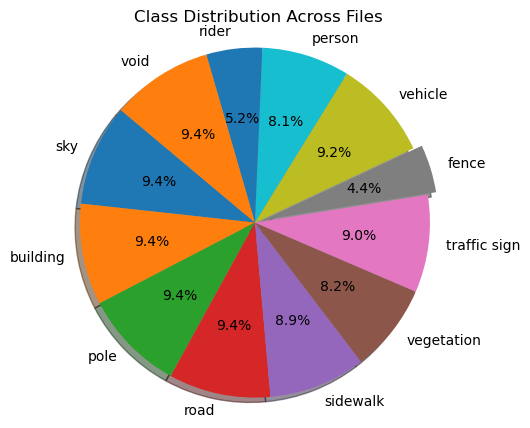

In [46]:
# Get labels from labels_df
labels = classes_df['label'].tolist()

# Ensure order matches class_counts keys
sizes = [len(classes_dict[i]) for i in range(len(labels))]

print(sizes)

# Optional: highlight smallest class
explode = [0.05 if i == 7 else 0 for i in range(len(labels))]  # Explode class 7: 'fence'

# Plot pie chart
plt.figure(figsize=(5,5))
plt.pie(
    sizes,
    labels=labels,
    autopct='%1.1f%%',
    startangle=140,
    explode=explode,
    shadow=True
)

plt.title("Class Distribution Across Files")
plt.axis('equal')  # Equal aspect ratio for a perfect circle
plt.show()


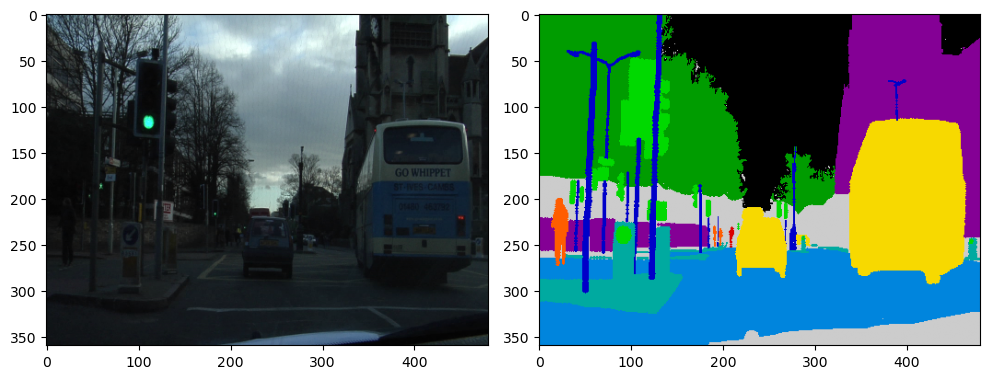

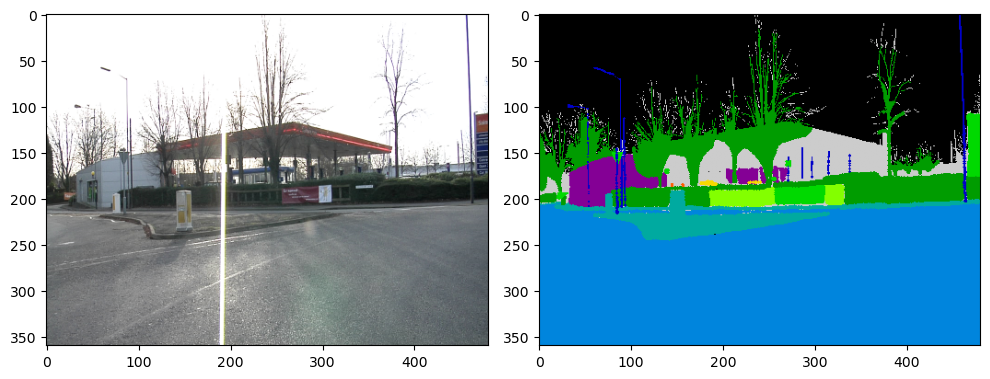

In [53]:
image = Image.open(os.path.join(TRAIN_IMG_PATH, files[10])).convert("RGB")
mask = Image.open(os.path.join(TRAIN_MASK_PATH, files[10])).convert("L")

fig, axs = plt.subplots(1, 2, figsize=(10, 5))
axs[0].imshow(image)
axs[1].imshow(mask, cmap='nipy_spectral')
plt.tight_layout()
plt.show()

image = Image.open(os.path.join(TRAIN_IMG_PATH, files[80])).convert("RGB")
mask = Image.open(os.path.join(TRAIN_MASK_PATH, files[80])).convert("L")

fig, axs = plt.subplots(1, 2, figsize=(10, 5))
axs[0].imshow(image)
axs[1].imshow(mask, cmap='nipy_spectral')
plt.tight_layout()
plt.show()

End of Script